In [1]:
import numpy as np 
import pandas as pd 
import plotly.express as px
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
%matplotlib inline
import scipy.stats as stats
import seaborn as sns
import datetime as dt
import math
import os

plt.style.use("fivethirtyeight")
plt.style.use("fast")

 # EDA:
      1- check the data types
      2- Univariant analysis
      3- Bi-variant analysis
      4- ckeck duplicates
      5- check missing values
      6- detect outliers
      7- feature engineering

* We've a dataset of US police deaths from 1791 to 2022We'll analyze the policemen deaths by the year the incidents happened and what caused them

###  Loading the Dataset:


In [2]:
df = pd.read_csv("police_deaths_in_america.csv")

In [3]:
df.head()

,Rank,Name,Cause_of_Death,Date,Year,Month,Day,Department,State,K9_Unit
0,Constable,Darius Quimby,Stabbed,"Monday, January 3, 1791",1791,January,Monday,"Albany County Constable's Office, NY",New York,0
1,Sheriff,Cornelius Hogeboom,Gunfire,"Saturday, October 22, 1791",1791,October,Saturday,"Columbia County Sheriff's Office, NY",New York,0
2,Deputy Sheriff,Isaac Smith,Gunfire,"Thursday, May 17, 1792",1792,May,Thursday,"Westchester County Sheriff's Department, NY",New York,0
3,Marshal,Robert Forsyth,Gunfire,"Saturday, January 11, 1794",1794,January,Saturday,United States Department of Justice - United S...,United States,0
4,Deputy Sheriff,Robert Berwick,Gunfire,"Thursday, June 29, 1797",1797,June,Thursday,"New York County Sheriff's Office, NY",New York,0


#### check the data types

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 26269 entries, 0 to 26268
Data columns (total 10 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   Rank            26269 non-null  object
 1   Name            26269 non-null  object
 2   Cause_of_Death  26269 non-null  object
 3   Date            26269 non-null  object
 4   Year            26269 non-null  int64 
 5   Month           26269 non-null  object
 6   Day             26269 non-null  object
 7   Department      26269 non-null  object
 8   State           26269 non-null  object
 9   K9_Unit         26269 non-null  int64 
dtypes: int64(2), object(8)
memory usage: 2.0+ MB


In [5]:
df.shape

(26269, 10)

* The dataset contains 26269 rows and 10 features
* The dataset contains 2 numerical features (K9_Unit, Year) and 8 categorical features (Rank, Name ,Cause_of_Death,Date,Month,Day,Department,State )


In [6]:
df.describe()

,Year,K9_Unit
count,26269.000000,26269.000000
mean,1955.712970,0.018387
std,41.248065,0.134348
min,1791.000000,0.000000
25%,1924.000000,0.000000
50%,1957.000000,0.000000
75%,1990.000000,0.000000
max,2022.000000,1.000000


##### ckeck duplicates

In [7]:
#df.duplicated().sum()
df[df.duplicated()]


,Rank,Name,Cause_of_Death,Date,Year,Month,Day,Department,State,K9_Unit


In [8]:
#missing data
total = df.isna().sum()[df.isna().sum()>0].sort_values(ascending=False)
percent = (df.isna().sum()[df.isna().sum()>0]/df.isna().sum()[df.isna().sum()>0].count()).sort_values(ascending=False)
missing_data = pd.concat([total, percent], axis=1, keys=['Total', 'Percent'])
missing_data

,Total,Percent


###  Univariate Analysis


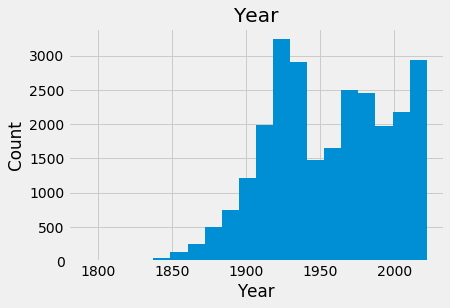

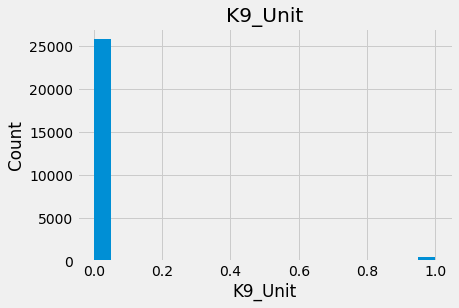

In [9]:
# Let's understand the distribution of the numerical variables by plotting the histograms

for feature in df.select_dtypes('number').columns:
    df=df.copy()
    df[feature].hist(bins=20)
    plt.xlabel(feature)
    plt.ylabel('Count')
    plt.title(feature)
    plt.show()

In [10]:
for cat in df.select_dtypes("number").columns:
    print(cat,":")
    print(df[cat].value_counts())
    print(df[cat].nunique())
    print("--"*10)
    fig=px.histogram(df,x=cat)
    fig.show()

Year :
2021    643
2020    436
1930    347
1927    335
1932    327
       ... 
1833      1
1824      1
1832      1
1827      1
1792      1
Name: Year, Length: 210, dtype: int64
210
--------------------


K9_Unit :
0    25786
1      483
Name: K9_Unit, dtype: int64
2
--------------------


* Distribution of Year is left skewed.




In [11]:
print("Skewness: %f" % df['Year'].skew())


Skewness: -0.193070


* the data Deviate from the normal distribution , has negative skewness

In [12]:
df.select_dtypes("object").columns

Index(['Rank', 'Name', 'Cause_of_Death', 'Date', 'Month', 'Day', 'Department',
       'State'],
      dtype='object')

In [13]:
for cat in df.select_dtypes("object").columns:
    print(cat,":")
    print(df[cat].value_counts())
    print(df[cat].nunique())
    print("--"*10)
    fig=px.histogram(df,x=cat)
    fig.show()

Rank :
Patrolman                             3876
Police Officer                        3549
Deputy Sheriff                        3224
Officer                               1746
Sergeant                              1423
                                      ... 
Guard Officer I                          1
Assistant Director                       1
Youth Officer                            1
Reserve Motor Deputy                     1
Senior Correctional Police Officer       1
Name: Rank, Length: 615, dtype: int64
615
--------------------


Name :
Max                        6
Rocky                      6
Roscoe                     5
Major                      5
King                       5
                          ..
Wilfred F. Golla           1
Frank E. Schoonmaker       1
Norman Pearson             1
Joseph V. Campbell, Jr.    1
Mina                       1
Name: Name, Length: 26044, dtype: int64
26044
--------------------


Cause_of_Death :
Gunfire                     13105
Automobile crash             2567
Heart attack                 1216
Motorcycle crash             1167
Vehicular assault            1000
Struck by vehicle             986
COVID19                       771
Assault                       712
Gunfire (Inadvertent)         693
Vehicle pursuit               692
Stabbed                       507
Aircraft accident             401
9/11 related illness          352
Struck by train               324
Drowned                       293
Duty related illness          256
Fall                          238
Heatstroke                    105
Animal related                 94
Accidental                     94
Electrocuted                   88
Terrorist attack               85
Struck by streetcar            77
Fire                           74
Explosion                      66
Bomb                           61
Exposure to toxins             58
Training accident              38
Weather/Natural disaster       

Date :
Tuesday, September 11, 2001    73
Wednesday, April 27, 1870      11
Friday, November 10, 1837      10
Saturday, November 24, 1917    10
Wednesday, August 25, 2021      9
                               ..
Sunday, June 21, 1936           1
Thursday, June 25, 1936         1
Sunday, June 28, 1936           1
Tuesday, June 30, 1936          1
Monday, May 2, 2022             1
Name: Date, Length: 19218, dtype: int64
19218
--------------------


Month :
September    2436
August       2420
July         2412
December     2395
October      2210
January      2165
November     2139
May          2121
April        2076
June         2060
March        1937
February     1898
Name: Month, dtype: int64
12
--------------------


Day :
Saturday     4070
Friday       3847
Sunday       3832
Thursday     3725
Tuesday      3613
Monday       3606
Wednesday    3576
Name: Day, dtype: int64
7
--------------------


Department :
New York City Police Department, NY                                         964
Chicago Police Department, IL                                               523
Puerto Rico Police Department, PR                                           358
Philadelphia Police Department, PA                                          320
United States Department of Justice - United States Marshals Service, US    306
                                                                           ... 
Lamar County Sheriff's Office, GA                                             1
Burkeville Police Department, VA                                              1
Fort Fairfield Police Department, ME                                          1
Lanett Police Department, AL                                                  1
Shepherdsville Police Department, KY                                          1
Name: Department, Length: 7307, dtype: int64
7307
--------------------


State :
Texas                       2229
United States               1970
New York                    1880
California                  1781
Illinois                    1174
Pennsylvania                1105
Florida                      976
Kentucky                     944
Ohio                         900
Georgia                      851
Tennessee                    729
Missouri                     723
Michigan                     649
North Carolina               635
Alabama                      619
Louisiana                    560
Virginia                     557
Oklahoma                     553
New Jersey                   544
Indiana                      484
South Carolina               429
Massachusetts                409
Puerto Rico                  398
Maryland                     347
Colorado                     344
Arkansas                     344
Mississippi                  330
Washington                   326
Arizona                      312
Wisconsin                    303
Ka

 * I will separate K9_Unit  to find some insights into the human police unit

In [14]:
#df.drop(columns=['Date', 'K9_Unit'], inplace = True)
human_police_deaths_df = df[df["K9_Unit"]==0].reset_index(drop=True)
human_police_deaths_df.drop("K9_Unit",axis=1,inplace=True)

human_police_deaths_df

,Rank,Name,Cause_of_Death,Date,Year,Month,Day,Department,State
0,Constable,Darius Quimby,Stabbed,"Monday, January 3, 1791",1791,January,Monday,"Albany County Constable's Office, NY",New York
1,Sheriff,Cornelius Hogeboom,Gunfire,"Saturday, October 22, 1791",1791,October,Saturday,"Columbia County Sheriff's Office, NY",New York
2,Deputy Sheriff,Isaac Smith,Gunfire,"Thursday, May 17, 1792",1792,May,Thursday,"Westchester County Sheriff's Department, NY",New York
3,Marshal,Robert Forsyth,Gunfire,"Saturday, January 11, 1794",1794,January,Saturday,United States Department of Justice - United S...,United States
4,Deputy Sheriff,Robert Berwick,Gunfire,"Thursday, June 29, 1797",1797,June,Thursday,"New York County Sheriff's Office, NY",New York
...,...,...,...,...,...,...,...,...,...
25781,Supervisory Police Officer,"Yiu Tak ""Louis"" Tao",9/11 related illness,"Tuesday, May 17, 2022",2022,May,Tuesday,United States Department of Justice - Federal ...,United States
25782,Senior Correctional Police Officer,Daniel Sincavage,Automobile crash,"Thursday, May 19, 2022",2022,May,Thursday,"New Jersey Department of Corrections, NJ",New Jersey
25783,Officer Trainee,Cody Alan Olafson,Duty related illness,"Friday, May 20, 2022",2022,May,Friday,United States Department of Homeland Security ...,United States
25784,Police Officer,Houston Tipping,Training accident,"Sunday, May 29, 2022",2022,May,Sunday,"Los Angeles Police Department, CA",California


In [15]:
human_police_deaths_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25786 entries, 0 to 25785
Data columns (total 9 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   Rank            25786 non-null  object
 1   Name            25786 non-null  object
 2   Cause_of_Death  25786 non-null  object
 3   Date            25786 non-null  object
 4   Year            25786 non-null  int64 
 5   Month           25786 non-null  object
 6   Day             25786 non-null  object
 7   Department      25786 non-null  object
 8   State           25786 non-null  object
dtypes: int64(1), object(8)
memory usage: 1.8+ MB


* 25786 human police deaths have been registered from 1791 to date


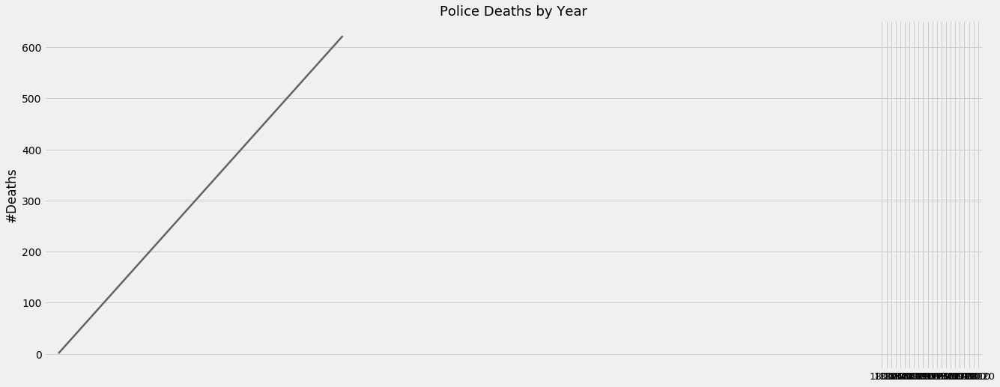

In [16]:

#grouping the human deaths by year
year_group = human_police_deaths_df.groupby('Year')['Name'].count()

plt.rcParams['figure.figsize'] = (20, 8)
sns.lineplot(x=year_group.index, y=year_group.values, data = year_group, linewidth = 2.5, color = '#626567')

plt.title("Police Deaths by Year", fontsize = 18)

plt.xlabel(None)
plt.ylabel('#Deaths')

plt.xticks(range(1800,2022,10), fontsize = 13)
plt.show()

* Counts of Registered Police Deaths by Year

In [17]:


l = ['Name','Cause_of_Death','Date','Month','Day','Department','State']

death_count_by_year_df = human_police_deaths_df.groupby(by="Year").count().drop(l,axis=1)
death_count_by_year_df = death_count_by_year_df.rename(columns={'Rank':'Count'})

death_count_by_year_df


,Count
Year,
1791,2
1792,1
1794,1
1797,2
1798,1
...,...
2018,188
2019,158
2020,414


In [18]:
death_count_by_year_df.describe()

,Count
count,210.000000
mean,122.790476
std,101.088733
min,1.000000
25%,20.250000
50%,129.500000
75%,185.000000
max,622.000000


In [19]:
round(np.mean(death_count_by_year_df["Count"]))

123

* on average, there are 123 police deaths per year.

* * the top 10 years with the most police deaths


In [20]:
death_count_by_year_df.sort_values(by='Count',ascending=False).head(10)

,Count
Year,
2021,622
2020,414
1930,347
1927,335
1932,327
1929,320
1931,318
1921,316
1922,311


* 2021  the highest death count of police deaths

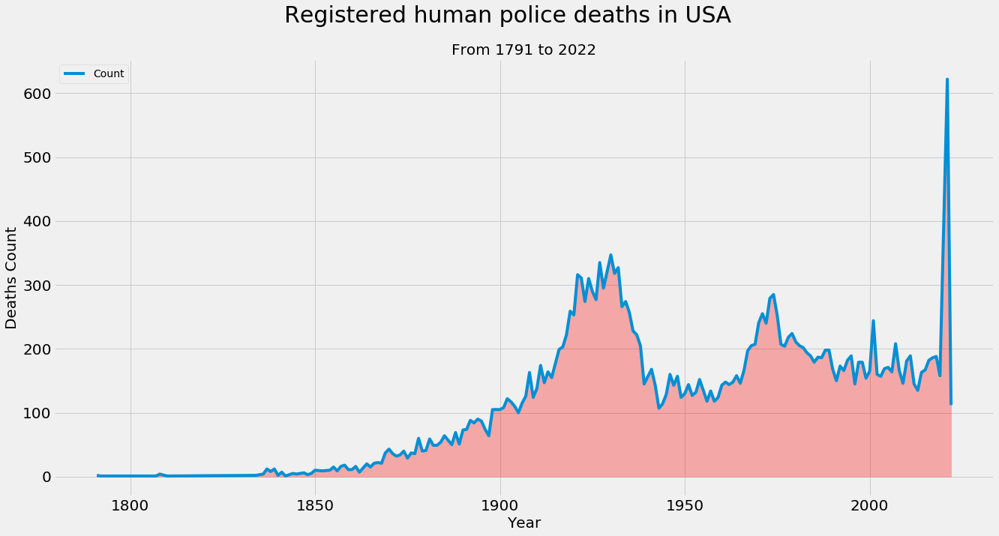

In [39]:
plt.figure(figsize=(20,10))

plot_1 = sns.lineplot(data=death_count_by_year_df)

plt.suptitle("Registered human police deaths in USA",fontsize=30)
plt.title("From 1791 to 2022",fontsize=20)

plt.xlabel("Year",fontsize=20)
plt.ylabel("Deaths Count",fontsize=20)

plt.xticks(fontsize=20)
plt.yticks(fontsize=20)

plt.fill_between(death_count_by_year_df.index,death_count_by_year_df["Count"], color='red', alpha=.3)
plt.show()

* there is a spike in the death count in 2020 and 2021
* * find out the reason for the spike


In [40]:
deaths_20_21_df = human_police_deaths_df[human_police_deaths_df["Year"]>2019]

deaths_20_21_df = deaths_20_21_df[deaths_20_21_df["Year"]<2022]
deaths_20_21_df.reset_index(drop=True,inplace=True)

deaths_20_21_df

,Rank,Name,Cause_of_Death,Date,Year,Month,Day,Department,State
0,Investigator,Ryan D. Fortini,9/11 related illness,"Wednesday, January 1, 2020",2020,January,Wednesday,"New York State Police, NY",New York
1,Police Officer,"Michael Lee Henry, Jr.",Motorcycle crash,"Thursday, January 2, 2020",2020,January,Thursday,"Derry Township Police Department, PA",Pennsylvania
2,Public Safety Officer,Jackson Ryan Winkeler,Gunfire,"Sunday, January 5, 2020",2020,January,Sunday,Florence Regional Airport Department of Public...,South Carolina
3,Police Officer,Paul Patrick Dunn,Motorcycle crash,"Thursday, January 9, 2020",2020,January,Thursday,"Lakeland Police Department, FL",Florida
4,Police Officer,Nicholas Lee Reyna,Struck by vehicle,"Saturday, January 11, 2020",2020,January,Saturday,"Lubbock Police Department, TX",Texas
...,...,...,...,...,...,...,...,...,...
1031,Detention Officer,Gary Lynn Bean,COVID19,"Thursday, December 30, 2021",2021,December,Thursday,"Conway County Sheriff's Office, AR",Arkansas
1032,Sergeant,Marlene Roberta Rittmanic,Gunfire,"Thursday, December 30, 2021",2021,December,Thursday,"Bradley Police Department, IL",Illinois
1033,Officer,Brian Vogel,COVID19,"Thursday, December 30, 2021",2021,December,Thursday,United States Department of Homeland Security ...,United States
1034,Sergeant,Thomas Edward Stanley,COVID19,"Friday, December 31, 2021",2021,December,Friday,"Atascadero State Hospital Police Department, CA",California


* the causes of human death count

In [41]:
#-----------------------------------------
l = ['Name','Date','Year','Month','Day','Department','State']

cause_of_death_count_20_21 = deaths_20_21_df.groupby(by="Cause_of_Death").count().drop(l,axis=1)
cause_of_death_count_20_21 = cause_of_death_count_20_21.rename(columns={'Rank':'Count'})

cause_of_death_count_20_21  

,Count
Cause_of_Death,
9/11 related illness,35
Aircraft accident,1
Assault,7
Automobile crash,43
COVID19,716
Drowned,7
Duty related illness,9
Exposure to toxins,1
Fall,1


* Due to COVID-19, a total of 716 police officers lost their lives in 2020 and 2021.  the pandemic caused that spike.

* *  causes of death from 1791 to 2022

In [42]:
overall_cause_of_death =  human_police_deaths_df.groupby(by="Cause_of_Death").count().drop(l,axis=1)
overall_cause_of_death = overall_cause_of_death.rename(columns={'Rank':'Count'})
overall_cause_of_death = overall_cause_of_death.sort_values(by="Count",ascending=False)

overall_cause_of_death

,Count
Cause_of_Death,
Gunfire,12965
Automobile crash,2540
Heart attack,1212
Motorcycle crash,1167
Vehicular assault,987
Struck by vehicle,928
COVID19,771
Assault,701
Vehicle pursuit,691


* Gunfire casualties are quite high

* *  relative frequency of causes of death

In [43]:
deaths_in_percent = []

for items in overall_cause_of_death["Count"]:
    percent = round((items / overall_cause_of_death["Count"].sum()) * 100,2)
    deaths_in_percent.append(percent)
    
overall_cause_of_death["Relative Frequency_%"] = deaths_in_percent 
overall_cause_of_death

,Count,Relative Frequency_%
Cause_of_Death,,
Gunfire,12965,50.28
Automobile crash,2540,9.85
Heart attack,1212,4.70
Motorcycle crash,1167,4.53
Vehicular assault,987,3.83
Struck by vehicle,928,3.60
COVID19,771,2.99
Assault,701,2.72
Vehicle pursuit,691,2.68


*  the top 10 causes of deaths

In [44]:
overall_cause_of_death.head(10)

,Count,Relative Frequency_%
Cause_of_Death,,
Gunfire,12965,50.28
Automobile crash,2540,9.85
Heart attack,1212,4.70
Motorcycle crash,1167,4.53
Vehicular assault,987,3.83
Struck by vehicle,928,3.60
COVID19,771,2.99
Assault,701,2.72
Vehicle pursuit,691,2.68


* Gunfire caused 13105 deaths. That is 49.89% of all deaths from 1791 to 2022. So, there is a 49.89% chance that a police officer will be killed in a shooting.


In [45]:
l = ['Name','Cause_of_Death','Date','Year','Day','Department','State']

deaths_month_wise = human_police_deaths_df.groupby(by="Month").count().drop(l,axis=1)
deaths_month_wise = deaths_month_wise.rename(columns={'Rank':'Count'})

deaths_month_wise = deaths_month_wise.reindex(["January","February","March","April","May",
                                               "June","July","August","September","October","November","December"])

deaths_month_wise

,Count
Month,
January,2121
February,1875
March,1904
April,2042
May,2090
June,2010
July,2350
August,2360
September,2397


In [46]:
sorted_deaths_month_wise = deaths_month_wise.sort_values(by="Count",ascending=False)
sorted_deaths_month_wise

,Count
Month,
September,2397
December,2365
August,2360
July,2350
October,2170
January,2121
November,2102
May,2090
April,2042


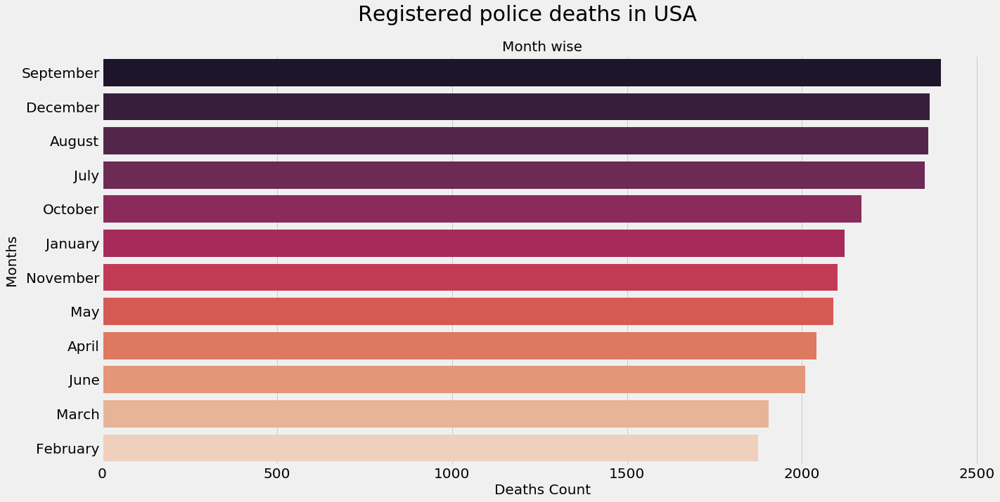

In [47]:
plt.figure(figsize=(20,10))

plot_2 = sns.barplot(data=sorted_deaths_month_wise,x=sorted_deaths_month_wise['Count'],
                     y=sorted_deaths_month_wise.index,palette="rocket")

plt.suptitle("Registered police deaths in USA",fontsize=30)
plt.title("Month wise",fontsize=20)

plt.xlabel("Deaths Count",fontsize=20)
plt.ylabel("Months",fontsize=20)

plt.xticks(fontsize=20)
plt.yticks(fontsize=20)

plt.show()


* Although there isn't much of a difference between September, December, August, and July, we can state that September is the deadliest month according to the graph

* * impact  the days  of the  police officers killed

In [48]:
l = ['Name','Cause_of_Death','Date','Year','Month','Department','State']
deaths_day_wise = human_police_deaths_df.groupby(by="Day").count().drop(l,axis=1)
deaths_day_wise = deaths_day_wise.rename(columns={'Rank':'Count'})
deaths_day_wise = deaths_day_wise.reindex(["Sunday","Monday","Tuesday","Wednesday","Thursday","Friday","Saturday"])
deaths_day_wise

,Count
Day,
Sunday,3778
Monday,3536
Tuesday,3537
Wednesday,3492
Thursday,3645
Friday,3779
Saturday,4019


In [49]:
sorted_deaths_day_wise = deaths_day_wise.sort_values(by="Count",ascending=False)
sorted_deaths_day_wise

,Count
Day,
Saturday,4019
Friday,3779
Sunday,3778
Thursday,3645
Tuesday,3537
Monday,3536
Wednesday,3492


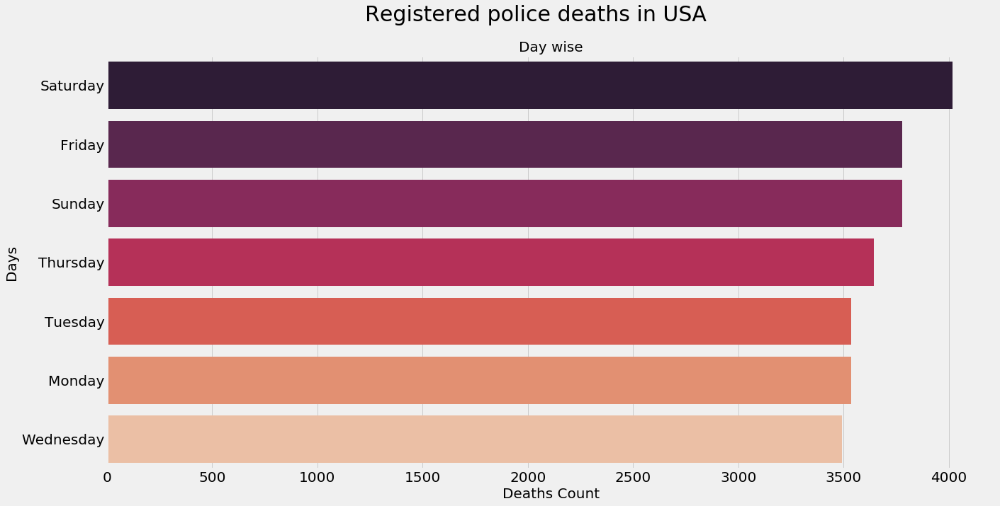

In [50]:
plt.figure(figsize=(20,10))

plot_3 = sns.barplot(data=sorted_deaths_day_wise,x=sorted_deaths_day_wise['Count'],
                     y=sorted_deaths_day_wise.index,palette="rocket")

plt.suptitle("Registered police deaths in USA",fontsize=30)
plt.title("Day wise",fontsize=20)

plt.xlabel("Deaths Count",fontsize=20)
plt.ylabel("Days",fontsize=20)

plt.xticks(fontsize=20)
plt.yticks(fontsize=20)

plt.show()

* The weekend caused more police deaths. It might be because more people go out on weekends, which might lead to an increase in public security and the deployment of more police on site, which might lead to more crimes and deaths

* Police deaths according to their rank

In [51]:
len(human_police_deaths_df["Rank"].unique())


614

* There are 614 unique ranks in the police department

* * the top ten police officer ranks, which are in greater danger than other ranks

In [52]:
l = ['Cause_of_Death','Date','Year','Month','Department','State','Day']

deaths_rank_wise = human_police_deaths_df.groupby(by="Rank").count().drop(l,axis=1)
deaths_rank_wise = deaths_rank_wise.rename(columns={'Name':'Count'})
deaths_rank_wise = deaths_rank_wise.sort_values(by="Count",ascending=False)

deaths_rank_wise.head(10)

,Count
Rank,
Patrolman,3876
Police Officer,3549
Deputy Sheriff,3224
Officer,1746
Sergeant,1423
Detective,861
Trooper,857
Sheriff,775
Chief of Police,691


* the ranks of the patrolman, police officer, and Deputy Sheriff are in more danger than other ranks.

*  the top 10 Departments with the most police deaths


In [53]:
l = ['Cause_of_Death','Date','Year','Month','Name','State','Day']

deaths_dept_wise =  human_police_deaths_df.groupby(by="Department").count().drop(l,axis=1)
deaths_dept_wise = deaths_dept_wise.rename(columns={'Rank':'Count'})
deaths_dept_wise = deaths_dept_wise.sort_values(by="Count",ascending=False)

deaths_dept_wise.head(10)

,Count
Department,
"New York City Police Department, NY",963
"Chicago Police Department, IL",515
"Puerto Rico Police Department, PR",358
"Philadelphia Police Department, PA",318
"United States Department of Justice - United States Marshals Service, US",306
"Detroit Police Department, MI",243
"California Highway Patrol, CA",231
"Los Angeles Police Department, CA",220
"St. Louis Metropolitan Police Department, MO",170


* New York City Police Department, NY loses the most police officers of any other department

* the top 10 States with the most police deaths


In [54]:
#---------------------------------------------
l = ['Cause_of_Death','Date','Year','Month','Name','Department','Day']

deaths_state_wise = human_police_deaths_df.groupby(by="State").count().drop(l,axis=1)
deaths_state_wise = deaths_state_wise.rename(columns={'Rank':'Count'})
deaths_state_wise = deaths_state_wise.sort_values(by="Count",ascending=False)

deaths_state_wise.head(10)


,Count
State,
Texas,2203
United States,1951
New York,1868
California,1730
Illinois,1158
Pennsylvania,1086
Kentucky,938
Florida,924
Ohio,888


*  Texas is the state where police are not safe


* check the data of the K9 unit
* * A police dog, also known as K-9 or K9 (a homophone of canine), is a dog specifically trained to assist members of law enforcement. Used as a means of law enforcement widely across the United States, Police K-9s usually serve in the force for 6 to 9 years.

In [55]:
k9_unit_df = df[df["K9_Unit"]==1].reset_index(drop=True)
k9_unit_df.drop("K9_Unit",axis=1,inplace=True)
k9_unit_df

,Rank,Name,Cause_of_Death,Date,Year,Month,Day,Department,State
0,K9,Vag,Struck by streetcar,"Thursday, April 12, 1877",1877,April,Thursday,"Buffalo Police Department, NY",New York
1,K9,Danger,Struck by train,"Tuesday, June 9, 1896",1896,June,Tuesday,"New York, Chicago and St. Louis Railroad Polic...",United States
2,K9,Ollie,Struck by vehicle,"Thursday, August 26, 1909",1909,August,Thursday,"New York City Police Department, NY",New York
3,K9,Trooper,Assault,"Friday, March 17, 1961",1961,March,Friday,"Kansas City Police Department, MO",Missouri
4,K9,Baron,Assault,"Wednesday, September 12, 1962",1962,September,Wednesday,"Virginia State Police, VA",Virginia
...,...,...,...,...,...,...,...,...,...
478,K9,Ciro,Fire,"Thursday, March 3, 2022",2022,March,Thursday,"Humphreys County Sheriff's Office, TN",Tennessee
479,K9,Dash,Gunfire,"Wednesday, March 9, 2022",2022,March,Wednesday,"Shepherdsville Police Department, KY",Kentucky
480,K9,Major,Gunfire,"Sunday, April 10, 2022",2022,April,Sunday,"Franklin County Sheriff's Office, NC",North Carolina
481,K9,Jinx,Gunfire,"Monday, April 11, 2022",2022,April,Monday,"El Paso County Sheriff's Office, CO",Colorado


In [56]:
k9_unit_df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 483 entries, 0 to 482
Data columns (total 9 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   Rank            483 non-null    object
 1   Name            483 non-null    object
 2   Cause_of_Death  483 non-null    object
 3   Date            483 non-null    object
 4   Year            483 non-null    int64 
 5   Month           483 non-null    object
 6   Day             483 non-null    object
 7   Department      483 non-null    object
 8   State           483 non-null    object
dtypes: int64(1), object(8)
memory usage: 34.1+ KB


* 483 K9 police dogs deaths have been registered from 1877 to date

* Counts of Registered K9 Deaths by Year

In [57]:
l = ['Name','Cause_of_Death','Date','Month','Day','Department','State']

k9_death_count_by_year_df = k9_unit_df.groupby(by="Year").count().drop(l,axis=1)
k9_death_count_by_year_df = k9_death_count_by_year_df.rename(columns={'Rank':'Count'})

k9_death_count_by_year_df



,Count
Year,
1877,1
1896,1
1909,1
1961,1
1962,1
1965,1
1966,2
1968,1
1969,1


In [58]:
k9_death_count_by_year_df.describe()


,Count
count,60.000000
mean,8.050000
std,8.310551
min,1.000000
25%,3.000000
50%,5.000000
75%,9.000000
max,36.000000


*  on average, there are 8 K9 deaths per year

* the top 10 years with the most K9 deaths

In [59]:
k9_death_count_by_year_df.sort_values(by='Count',ascending=False).head(10)


,Count
Year,
2016,36
2019,28
2018,28
2015,27
2017,24
2020,22
2013,22
2021,21
2014,20


* 2016 registered the highest death count of K9 deaths

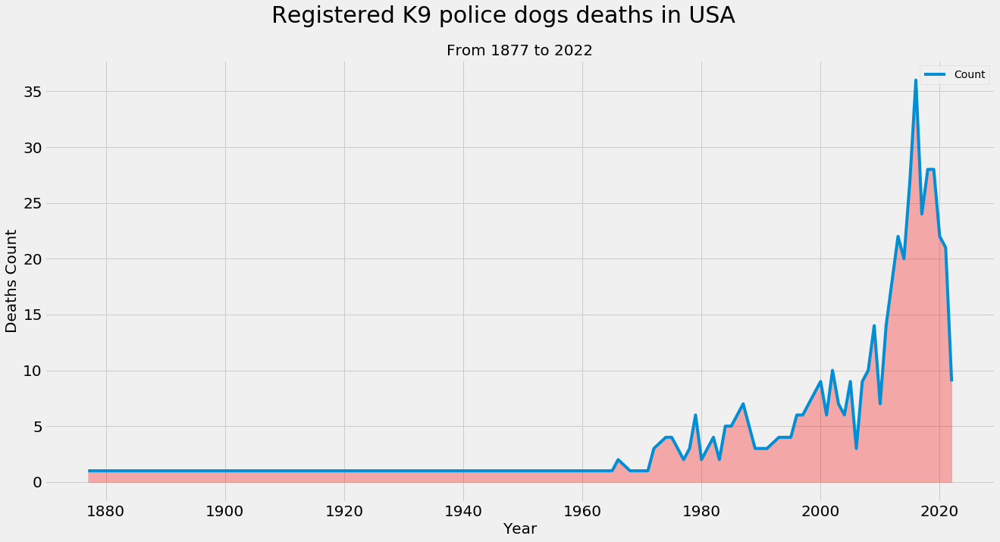

In [60]:
plt.figure(figsize=(20,10))

plot_4 = sns.lineplot(data=k9_death_count_by_year_df)

plt.suptitle("Registered K9 police dogs deaths in USA",fontsize=30)
plt.title("From 1877 to 2022",fontsize=20)

plt.xlabel("Year",fontsize=20)
plt.ylabel("Deaths Count",fontsize=20)

plt.xticks(fontsize=20)
plt.yticks(fontsize=20)

plt.fill_between(k9_death_count_by_year_df.index,k9_death_count_by_year_df["Count"], color='red', alpha=.3)

plt.show()


*  the various causes of K9 deaths from 1877 to 2022


In [61]:
l = ['Name','Date','Month',"Year",'Day','Department','State']

k9_overall_cause_of_death = k9_unit_df.groupby(by="Cause_of_Death").count().drop(l,axis=1)
k9_overall_cause_of_death = k9_overall_cause_of_death.rename(columns={'Rank':'Count'})
k9_overall_cause_of_death = k9_overall_cause_of_death.sort_values(by="Count",ascending=False)

k9_overall_cause_of_death



,Count
Cause_of_Death,
Gunfire,140
Heatstroke,81
Struck by vehicle,58
Automobile crash,27
Gunfire (Inadvertent),26
Fall,25
Stabbed,24
Duty related illness,19
Vehicular assault,13


In [62]:
k9_deaths_in_percent = []
for items in k9_overall_cause_of_death["Count"]:
    percent = round((items / k9_overall_cause_of_death["Count"].sum()) * 100,2)
    k9_deaths_in_percent.append(percent)
    
k9_overall_cause_of_death["Relative Frequency_%"] = k9_deaths_in_percent  
k9_overall_cause_of_death

,Count,Relative Frequency_%
Cause_of_Death,,
Gunfire,140,28.99
Heatstroke,81,16.77
Struck by vehicle,58,12.01
Automobile crash,27,5.59
Gunfire (Inadvertent),26,5.38
Fall,25,5.18
Stabbed,24,4.97
Duty related illness,19,3.93
Vehicular assault,13,2.69


* the top 10 causes of deaths with the most K9 deaths


In [63]:
k9_overall_cause_of_death.sort_values(by='Count',ascending=False).head(10)

,Count,Relative Frequency_%
Cause_of_Death,,
Gunfire,140,28.99
Heatstroke,81,16.77
Struck by vehicle,58,12.01
Automobile crash,27,5.59
Gunfire (Inadvertent),26,5.38
Fall,25,5.18
Stabbed,24,4.97
Duty related illness,19,3.93
Vehicular assault,13,2.69


* Gunfire, like in human units, is at the top of the list. We can say that gun violence is higher in the US

* impact the month on the number of K9 killed

In [64]:
l = ['Name','Cause_of_Death','Date','Year','Day','Department','State']

k9_deaths_month_wise = k9_unit_df.groupby(by="Month").count().drop(l,axis=1)
k9_deaths_month_wise = k9_deaths_month_wise.rename(columns={'Rank':'Count'})

k9_deaths_month_wise = k9_deaths_month_wise.reindex(["January","February","March","April","May",
                                                     "June","July","August","September","October","November","December"])

k9_deaths_month_wise


,Count
Month,
January,44
February,23
March,33
April,34
May,31
June,50
July,62
August,60
September,39


In [65]:
k9_sorted_deaths_month_wise = k9_deaths_month_wise.sort_values(by="Count",ascending=False)
k9_sorted_deaths_month_wise

,Count
Month,
July,62
August,60
June,50
January,44
October,40
September,39
November,37
April,34
March,33


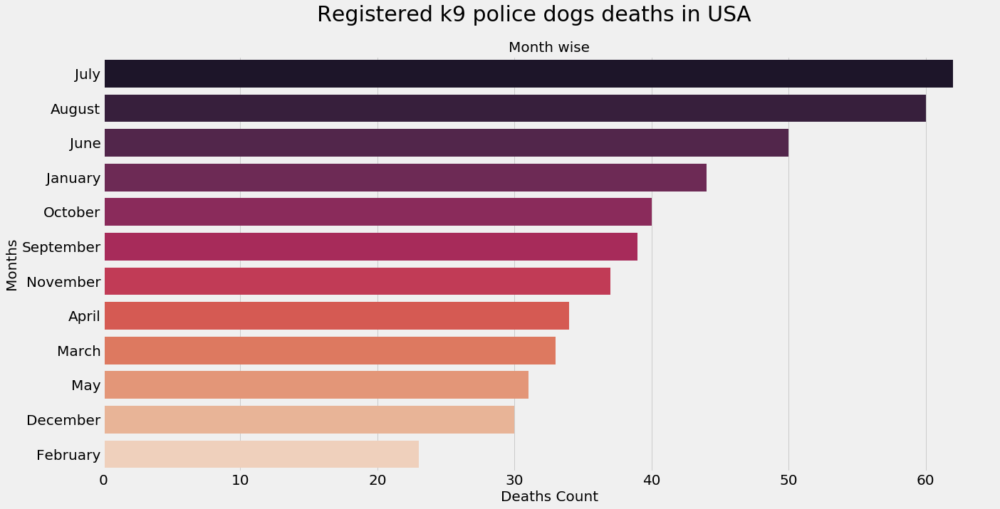

In [66]:
plt.figure(figsize=(20,10))

plot_5 = sns.barplot(data=k9_sorted_deaths_month_wise,x=k9_sorted_deaths_month_wise['Count'],
                     y=k9_sorted_deaths_month_wise.index,palette="rocket")

plt.suptitle("Registered k9 police dogs deaths in USA",fontsize=30)
plt.title("Month wise",fontsize=20)

plt.xlabel("Deaths Count",fontsize=20)
plt.ylabel("Months",fontsize=20)

plt.xticks(fontsize=20)
plt.yticks(fontsize=20)


plt.show()


* July and August are at the top 

* impact  the days  on the number of K9 killed

In [67]:
l = ['Name','Cause_of_Death','Date','Year','Month','Department','State']

k9_deaths_day_wise = k9_unit_df.groupby(by="Day").count().drop(l,axis=1)
k9_deaths_day_wise = k9_deaths_day_wise.rename(columns={'Rank':'Count'})

k9_deaths_day_wise = k9_deaths_day_wise.reindex(["Sunday","Monday","Tuesday","Wednesday","Thursday","Friday","Saturday"])

k9_deaths_day_wise

,Count
Day,
Sunday,54
Monday,70
Tuesday,76
Wednesday,84
Thursday,80
Friday,68
Saturday,51


In [68]:
k9_sorted_deaths_day_wise = k9_deaths_day_wise.sort_values(by="Count",ascending=False)
k9_sorted_deaths_day_wise

,Count
Day,
Wednesday,84
Thursday,80
Tuesday,76
Monday,70
Friday,68
Sunday,54
Saturday,51


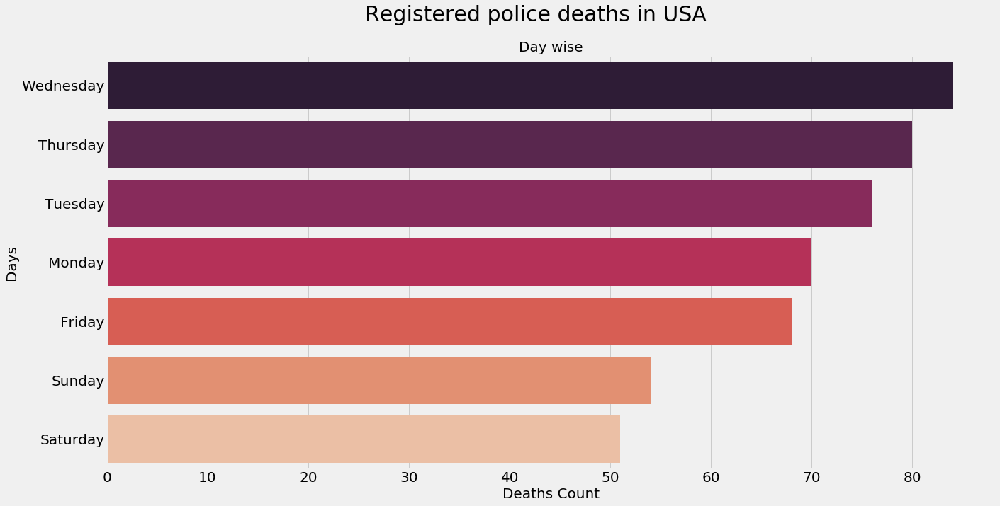

In [69]:
plt.figure(figsize=(20,10))

plot_6 = sns.barplot(data=k9_sorted_deaths_day_wise,x=k9_sorted_deaths_day_wise['Count'],y=k9_sorted_deaths_day_wise.index,palette="rocket")

plt.suptitle("Registered police deaths in USA",fontsize=30)
plt.title("Day wise",fontsize=20)

plt.xlabel("Deaths Count",fontsize=20)
plt.ylabel("Days",fontsize=20)

plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.show()


* Its reverse here from human unit

*  the top 10 Departments with the most K9 deaths


In [70]:
l = ['Cause_of_Death','Date','Year','Month','Name','State','Day']

k9_deaths_dept_wise = k9_unit_df.groupby(by="Department").count().drop(l,axis=1)
k9_deaths_dept_wise = k9_deaths_dept_wise.rename(columns={'Rank':'Count'})

k9_deaths_dept_wise = k9_deaths_dept_wise.sort_values(by="Count",ascending=False)

k9_deaths_dept_wise.head(10)

,Count
Department,
"Chicago Police Department, IL",8
"Phoenix Police Department, AZ",7
"United States Department of Homeland Security - Customs and Border Protection - United States Border Patrol, US",6
"Norfolk Police Department, VA",5
"Michigan State Police, MI",4
"Pittsburgh Bureau of Police, PA",4
"Tacoma Police Department, WA",4
"Bexar County Sheriff's Office, TX",4
"Sacramento County Sheriff's Department, CA",4


* Chicago Police Department, IL tops the list

* the top 10 States with the most K9 deaths


In [71]:
l = ['Cause_of_Death','Date','Year','Month','Name','Department','Day']

k9_deaths_state_wise = k9_unit_df.groupby(by="State").count().drop(l,axis=1)
k9_deaths_state_wise = k9_deaths_state_wise.rename(columns={'Rank':'Count'})

k9_deaths_state_wise = k9_deaths_state_wise.sort_values(by="Count",ascending=False)

k9_deaths_state_wise.head(10)

,Count
State,
Florida,52
California,51
Arizona,31
Texas,26
Virginia,23
Indiana,21
United States,19
Pennsylvania,19
Illinois,16


* Florida and California tops the list

In [72]:
# Human Unit count
humans_df = df[df["K9_Unit"]==0].reset_index(drop=True)
humans_df = humans_df.drop("K9_Unit",axis=1)

# Making Count df
l = ['Name','Cause_of_Death','Date','Month','Day','Department','State']
count_df = humans_df.groupby(by="Year").count().drop(l,axis=1)
count_df = count_df.rename(columns={'Rank':'Count_Human_Unit'})

# Transfering to all unit death counts df
all_unit_count = count_df.tail(23)
all_unit_count = all_unit_count.drop(index=2022,axis=0)

# K9 Unit count
k9_df = df[df["K9_Unit"]==1].reset_index(drop=True)
k9_df = k9_df.drop("K9_Unit",axis=1)

# Making Count df
l = ['Name','Cause_of_Death','Date','Month','Day','Department','State']
k9_count_df = k9_df.groupby(by="Year").count().drop(l,axis=1)
k9_count_df = k9_count_df.rename(columns={'Rank':'Count_K9_Unit'})

# Filtering years
fil_k9_count_df = k9_count_df.tail(23)
fil_k9_count_df = fil_k9_count_df.drop(index=2022,axis=0)

# Transfering to all unit death counts df
all_unit_count["Count_K9_Unit"] = fil_k9_count_df["Count_K9_Unit"]

# Making a Total column
all_unit_count["Combined"] = all_unit_count["Count_Human_Unit"] + all_unit_count["Count_K9_Unit"]

all_unit_count


,Count_Human_Unit,Count_K9_Unit,Combined
Year,,,
2000,165,9,174
2001,244,6,250
2002,160,10,170
2003,157,7,164
2004,169,6,175
2005,171,9,180
2006,164,3,167
2007,208,9,217
2008,166,10,176


In [73]:
#pivotting the data
#year_covid_pivot = pd.pivot_table(data=human_police_deaths_df, index=['Year','Month'], values='Name', aggfunc='count').reset_index()

#plotting the bar graph
#plt.rcParams['figure.figsize'] = (24, 7)
#sns.barplot(x='Month', y='Name', data = year_covid_pivot, hue = 'Year')

#plt.title("COVID Induced Police Deaths by Year", fontsize = 18)

#plt.xlabel(None)
#plt.ylabel('Deaths')

#plt.show()

### check outliers:

In [74]:
from datasist.structdata import detect_outliers

In [75]:
for col in df :
    fig=px.box(df[col])
    fig.show()
    

* Boxplot does show we have some outliers.


In [58]:
idx=detect_outliers(df,0,['Year'])


In [59]:
idx

[0,
 1,
 2,
 3,
 4,
 5,
 6,
 7,
 8,
 9,
 10,
 11,
 12,
 13,
 14,
 15,
 16,
 17,
 18,
 19,
 20,
 21,
 22]

In [60]:
len(idx)

23

In [61]:
(23/df.shape[0])*100

0.08755567398835129

In [62]:
df.drop(idx , axis = 0 , inplace = True)
#df['temperature'].replace(df['temperature'].mean())

In [63]:
detect_outliers(df,0,['Year'])

[]

In [64]:
idx_K9_Unit=detect_outliers(df,0,['K9_Unit'])

In [65]:
len(idx_K9_Unit)

483

In [66]:
(483/df.shape[0])*100

1.840280423683609

In [67]:
df.drop(idx_K9_Unit , axis = 0 , inplace = True)

In [68]:
detect_outliers(df,0,['K9_Unit'])

[]

In [69]:
#df['K9_Unit'].tolist()

In [70]:
df.reset_index(drop = True , inplace = True)

In [71]:
df.isnull().sum()

Rank              0
Name              0
Cause_of_Death    0
Date              0
Year              0
Month             0
Day               0
Department        0
State             0
K9_Unit           0
dtype: int64

### corrolation  between variables:

In [72]:
df.columns

Index(['Rank', 'Name', 'Cause_of_Death', 'Date', 'Year', 'Month', 'Day',
       'Department', 'State', 'K9_Unit'],
      dtype='object')

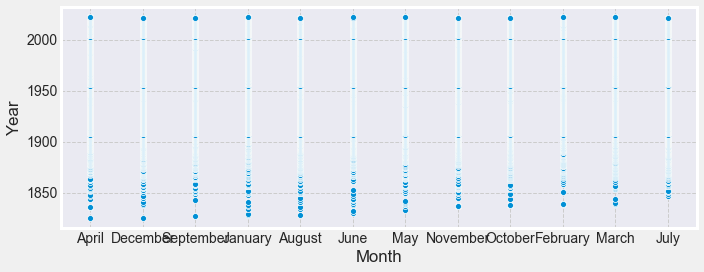

In [73]:
plt.figure(figsize=(10,4))
sns.set_style(style='darkgrid', rc={"grid.color": ".8", "grid.linestyle": "--"})
sns.scatterplot(y=df['Year'],x=df['Month'],palette='RdYlGn_r')
plt.tight_layout()
plt.grid(True)
plt.show()

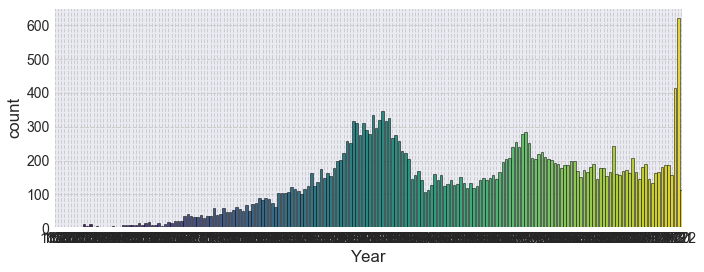

In [74]:
plt.figure(figsize=(10,4))
sns.set_style(style='darkgrid', rc={"grid.color": ".8", "grid.linestyle": "--"})
sns.countplot(x=df['Year'],palette='viridis',saturation=0.8,edgecolor="black")
plt.tight_layout()
plt.grid(True)
plt.show()

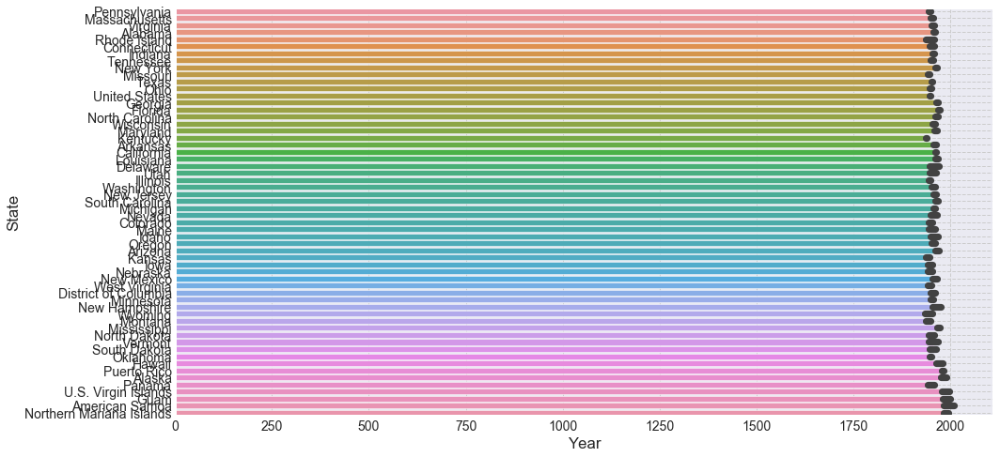

In [75]:
plt.figure(figsize=(15,7))
sns.barplot(x=df.Year, y=df.State)

plt.tight_layout()
plt.grid(True)
plt.show()

In [76]:

df[["Cause_of_Death"]].sort_values("Cause_of_Death", ascending=False).style.format(
    precision=3
).background_gradient(cmap="Greys")

,Cause_of_Death
14129,Weather/Natural disaster
12770,Weather/Natural disaster
739,Weather/Natural disaster
9815,Weather/Natural disaster
5114,Weather/Natural disaster
17236,Weather/Natural disaster
1091,Weather/Natural disaster
10856,Weather/Natural disaster
22504,Weather/Natural disaster
23874,Weather/Natural disaster


### Data Transformation 

In [77]:
#df['Cause_of_Death'].value_counts()
#-----------------------------
(df[["Cause_of_Death"]]
     .value_counts()
     .nlargest(20)
     .reset_index()
     .loc[:, "Cause_of_Death"].to_list())

['Gunfire',
 'Automobile crash',
 'Heart attack',
 'Motorcycle crash',
 'Vehicular assault',
 'Struck by vehicle',
 'COVID19',
 'Assault',
 'Vehicle pursuit',
 'Gunfire (Inadvertent)',
 'Stabbed',
 'Aircraft accident',
 '9/11 related illness',
 'Struck by train',
 'Drowned',
 'Duty related illness',
 'Fall',
 'Accidental',
 'Electrocuted',
 'Animal related']

In [78]:
df[df['Cause_of_Death']=='Gunfire'].count()

Rank              12953
Name              12953
Cause_of_Death    12953
Date              12953
Year              12953
Month             12953
Day               12953
Department        12953
State             12953
K9_Unit           12953
dtype: int64

In [79]:
df['Cause_of_Death'].unique()

array(['Gunfire', 'Assault', 'Stabbed', 'Fall', 'Drowned',
       'Duty related illness', 'Structure collapse', 'Fire',
       'Gunfire (Inadvertent)', 'Explosion', 'Vehicular assault',
       'Animal related', 'Heart attack', 'Weather/Natural disaster',
       'Accidental', 'Hypothermia', 'Heatstroke', 'Train accident',
       'Struck by streetcar', 'Struck by train', 'Bomb', 'Poisoned',
       'Electrocuted', 'Boating accident', 'Bicycle accident',
       'Struck by vehicle', 'Automobile crash', 'Unidentified',
       'Exposure to toxins', 'Motorcycle crash', 'Vehicle pursuit',
       'Training accident', 'Aircraft accident', 'Terrorist attack',
       '9/11 related illness', 'COVID19'], dtype=object)

In [80]:
df[df['Cause_of_Death']=='9/11 related illness'].count()

Rank              352
Name              352
Cause_of_Death    352
Date              352
Year              352
Month             352
Day               352
Department        352
State             352
K9_Unit           352
dtype: int64

In [81]:

df['Cause_of_Death']=df['Cause_of_Death'].replace({
    '9/11 related illness':'related illness'
})

In [82]:
df['Cause_of_Death'].unique()

array(['Gunfire', 'Assault', 'Stabbed', 'Fall', 'Drowned',
       'Duty related illness', 'Structure collapse', 'Fire',
       'Gunfire (Inadvertent)', 'Explosion', 'Vehicular assault',
       'Animal related', 'Heart attack', 'Weather/Natural disaster',
       'Accidental', 'Hypothermia', 'Heatstroke', 'Train accident',
       'Struck by streetcar', 'Struck by train', 'Bomb', 'Poisoned',
       'Electrocuted', 'Boating accident', 'Bicycle accident',
       'Struck by vehicle', 'Automobile crash', 'Unidentified',
       'Exposure to toxins', 'Motorcycle crash', 'Vehicle pursuit',
       'Training accident', 'Aircraft accident', 'Terrorist attack',
       'related illness', 'COVID19'], dtype=object)

In [83]:

def clean_Cause_of_Death(Cause_of_Death):
    
    if '/' in Cause_of_Death:
        Cause_of_Death=Cause_of_Death.replace('/','')
    elif '(' in Cause_of_Death:
        Cause_of_Death=Cause_of_Death.replace('(','')
    elif ')' in Cause_of_Death:
        Cause_of_Death=Cause_of_Death.replace(')','')
    elif 'COVID19' in Cause_of_Death:
        Cause_of_Death=Cause_of_Death.split('19')[0] # split 19 from covid19
        #Cause_of_Death=Cause_of_Death[:5]
        
    return Cause_of_Death
df['Cause_of_Death']=df['Cause_of_Death'].apply(clean_Cause_of_Death)
    

In [84]:
df['Cause_of_Death'].unique()

array(['Gunfire', 'Assault', 'Stabbed', 'Fall', 'Drowned',
       'Duty related illness', 'Structure collapse', 'Fire',
       'Gunfire Inadvertent)', 'Explosion', 'Vehicular assault',
       'Animal related', 'Heart attack', 'WeatherNatural disaster',
       'Accidental', 'Hypothermia', 'Heatstroke', 'Train accident',
       'Struck by streetcar', 'Struck by train', 'Bomb', 'Poisoned',
       'Electrocuted', 'Boating accident', 'Bicycle accident',
       'Struck by vehicle', 'Automobile crash', 'Unidentified',
       'Exposure to toxins', 'Motorcycle crash', 'Vehicle pursuit',
       'Training accident', 'Aircraft accident', 'Terrorist attack',
       'related illness', 'COVID'], dtype=object)

In [85]:
df['Cause_of_Death']=df['Cause_of_Death'].replace({
    'WeatherNatural disaster':'Natural disaster'
})

In [86]:
df['Cause_of_Death'].unique()

array(['Gunfire', 'Assault', 'Stabbed', 'Fall', 'Drowned',
       'Duty related illness', 'Structure collapse', 'Fire',
       'Gunfire Inadvertent)', 'Explosion', 'Vehicular assault',
       'Animal related', 'Heart attack', 'Natural disaster', 'Accidental',
       'Hypothermia', 'Heatstroke', 'Train accident',
       'Struck by streetcar', 'Struck by train', 'Bomb', 'Poisoned',
       'Electrocuted', 'Boating accident', 'Bicycle accident',
       'Struck by vehicle', 'Automobile crash', 'Unidentified',
       'Exposure to toxins', 'Motorcycle crash', 'Vehicle pursuit',
       'Training accident', 'Aircraft accident', 'Terrorist attack',
       'related illness', 'COVID'], dtype=object)

In [87]:
df['Rank'].unique()

array(['Constable', 'Watch Officer', 'Watchman', 'Sheriff',
       'Town Sergeant', 'Guard', 'Deputy Sheriff', 'Private',
       'Second Lieutenant', 'Deputy U.S. Marshal', 'Captain',
       'First Sergeant', 'Town Marshal', 'Prison Guard', 'Warden',
       'Keeper', 'Undersheriff', 'Lieutenant', 'Patrolman', 'Major',
       'Police Officer', 'Sergeant', 'Night Watchman', 'Deputy Constable',
       'Shadow', 'Officer', 'Policeman', 'Indian Agent', 'Marshal',
       'City Marshal', 'Deputy Warden', 'Deputized Civilian',
       'Assistant City Marshal', 'Special Patrolman',
       'Special Police Officer', 'Jailer', 'Patrol Officer', 'Deputy',
       'Deputy City Marshal', 'Inspector', 'Deputy Collector',
       'Special Agent', 'Deputy Marshal', 'Deputy Provost Marshal',
       'Assistant Provost Marshal', 'Chief of Police',
       'Customs Inspector', 'Township Constable', 'Posseman',
       'Police Deputy', 'Special Constable', 'Special Officer',
       'Special Deputy Constable', 'Ga

In [88]:
def clean_Rank(Rank):    
    if 'U.S.' in Rank:
        Rank=Rank.replace('U.S.','United Stade')
    elif '-' in Rank:
        Rank=Rank.replace('-','')
    elif 'I' in Rank:
        Rank=Rank.replace('I','')
    elif 'II' in Rank:
        Rank=Rank.replace('II','')
    elif 'III' in Rank:
        Rank=Rank.replace('III','')
    elif '/' in Rank:
        Rank=Rank.replace('/','')
    elif 'V' in Rank:
        Rank=Rank.replace('V','')
    elif 'll' in Rank:
        Rank=Rank.replace('ll','')
    elif 'IV' in Rank:
        Rank=Rank.replace('IV','')
    
    elif 'K9' in Rank:
        Rank=Rank.replace('k9','')
        
    return Rank
df['Rank']=df['Rank'].apply(clean_Rank)

In [89]:
df['Rank'].unique()

array(['Constable', 'Watch Officer', 'Watchman', 'Sheriff',
       'Town Sergeant', 'Guard', 'Deputy Sheriff', 'Private',
       'Second Lieutenant', 'Deputy United Stade Marshal', 'Captain',
       'First Sergeant', 'Town Marshal', 'Prison Guard', 'Warden',
       'Keeper', 'Undersheriff', 'Lieutenant', 'Patrolman', 'Major',
       'Police Officer', 'Sergeant', 'Night Watchman', 'Deputy Constable',
       'Shadow', 'Officer', 'Policeman', 'ndian Agent', 'Marshal',
       'City Marshal', 'Deputy Warden', 'Deputized Civilian',
       'Assistant City Marshal', 'Special Patrolman',
       'Special Police Officer', 'Jailer', 'Patrol Officer', 'Deputy',
       'Deputy City Marshal', 'nspector', 'Deputy Coector',
       'Special Agent', 'Deputy Marshal', 'Deputy Provost Marshal',
       'Assistant Provost Marshal', 'Chief of Police', 'Customs nspector',
       'Township Constable', 'Posseman', 'Police Deputy',
       'Special Constable', 'Special Officer', 'Special Deputy Constable',
       

In [90]:

print(df.Name.unique().tolist())

['William Davidson', 'Jonathan Houghton', 'Gerrard Arnold', 'Steven Heimer', 'Robert McGuffin', 'Silas Goree', 'Thomas Griffin Thornton', 'John Smith', 'Ezra Hoskins', 'William Gresham', 'Moore C. Wisdom', 'Luciese Lewis Leuba', 'William Mull', 'George Hammond', 'Kim Hudson', 'David Clark', 'James Coryell', 'Alfred H. Miles', 'Jesse Blair', 'Alexander Bostwick', 'James Christian', 'Joseph Cooper', 'James Joslen', 'Westley Nicholson', 'William Nicholson', 'William Sanders', 'Lewis F. Scheuster', 'Nester Young', 'John Batts', 'Pliny D. Wells', 'Julius Bullock', 'John W. Carpenter', 'Thomas M. Scott', 'John Wilson', 'James Hall', 'John Gatewood', 'Jacob Shipman Burleson', 'Edward Blakey', 'John B. Walters', 'James Gilleland', 'John Bird', 'William H. Weaver', 'Jesse E. Nash', 'Thomas Gay', 'H. M. C. Hall', 'James P. Van Duzen', 'John Kimmey', 'Joseph L. Hood', 'John Yeomans', 'John B. Campbell', 'John B. Denton', 'Cyrus Sells', 'William Bullard', 'Abram Trigg Smith', 'George W. Heard', 'W

In [91]:
#df[df['Name']=='R.O.C.C.O.']

In [92]:
#df[df['Name']=='R.J.']

In [93]:
#df[df['Name']=='Nr ']

In [94]:
#df[df['Name']==' E. ']#.count()

In [95]:
#idx=df[df['Name']=='R.O.C.C.O.'].index
#df=df.drop(idx,axis=0)

#idx=df[df['Name']=='R.J.'].index
#df=df.drop(idx,axis=0)

#idx=df[df['Name']=='Nr '].index
#df=df.drop(idx,axis=0)

#idx=df[df['Name']==' E. '].index
#df=df.drop(idx,axis=0)

In [96]:
def clean_Name(Name):    
    if 'A.' in Name:
        Name=Name.replace('A.','')
    elif 'McCoy' in Name:
        Name=Name.replace('McCoy','')
    elif 'Young' in Name:
        Name=Name.replace('Young','')
    elif 'Big' in Name:
        Name=Name.replace('Big','')
    elif 'Cook' in Name:
        Name=Name.replace('Cook','')
    elif 'Van' in Name:
        Name=Name.replace('Van','')
    elif 'Ive' in Name:
        Name=Name.replace('Ive','')
    elif 'Di' in Name:
        Name=Name.replace('Di','')
    elif 'Long' in Name:
        Name=Name.replace('Long','')
    elif 'Pop' in Name:
        Name=Name.replace('Pop','')
    elif 'Green' in Name:
        Name=Name.replace('Green','')
    elif 'Sgt.' in Name:
        Name=Name.replace('Sgt.','')
    elif 'Vom' in Name:
        Name=Name.replace('Vom','')
    elif ',' in Name:
        Name=Name.replace(',','')
    elif 'Fox' in Name:
        Name=Name.replace('Fox','')
    elif 'Jr.' in Name:
        Name=Name.replace('Jr.','')
    elif 'RJ' in Name:
        Name=Name.replace('RJ','')
    elif '-' in Name:
        Name=Name.replace('-','')        
    elif 'Vu' in Name:
        Name=Name.replace('Vu','')
    elif 'De' in Name:
        Name=Name.replace('De','')
    elif 'La' in Name:
        Name=Name.replace('La','')
    elif 'Q.' in Name:
        Name=Name.replace('Q.','')
    elif 'Te' in Name:
        Name=Name.replace('Te','')
    elif 'Sr.' in Name:
        Name=Name.replace('Sr.','')
    elif 'E.' in Name:
        Name=Name.replace('E.','')
    elif 'P.' in Name:
        Name=Name.replace('P.','')
    elif 'Y' in Name:
        Name=Name.replace('Y','')
    elif 'H.' in Name:
        Name=Name.replace('H.','')
    elif 'L.' in Name:
        Name=Name.replace('L.','')
    elif 'I.' in Name:
        Name=Name.replace('I.','')
    elif 'C.' in Name:
        Name=Name.replace('C.','')
    elif 'O.' in Name:
        Name=Name.replace('O.','')
    elif 'N.' in Name:
        Name=Name.replace('N.','')
    elif 'V' in Name:
        Name=Name.replace('V','')
    elif 'V.' in Name:
        Name=Name.replace('V.','')
    elif 'F.' in Name:
        Name=Name.replace('F.','')
    elif 'C.' in Name:
        Name=Name.replace('C.','')
    elif 'S.' in Name:
        Name=Name.replace('S.','')
    elif 'Y' in Name:
        Name=Name.replace('Y','')
    elif 'D.' in Name:
        Name=Name.replace('D.','')
    elif 'T.' in Name:
        Name=Name.replace('T.','')
    elif 'G.' in Name:
        Name=Name.replace('G.','')
    elif 'W.' in Name:
        Name=Name.replace('W.','')
    elif 'M.' in Name:
        Name=Name.replace('M.','')
    elif 'B.' in Name:
        Name=Name.replace('B.','')
    elif 'R.' in Name:
        Name=Name.replace('R.','')
    elif 'J.' in Name:
        Name=Name.replace('J.','')
    elif 'K.' in Name:
        Name=Name.replace('K.','')
    elif 'Doc' in Name:
        Name=Name.replace('Doc','')
    elif 'JH' in Name:
        Name=Name.replace('JH','')
    elif 'Ed' in Name:
        Name=Name.replace('Ed','')
    elif 'X.' in Name:
        Name=Name.replace('X.','')
    elif 'U.' in Name:
        Name=Name.replace('U.','')
    elif 'Y.' in Name:
        Name=Name.replace('Y.','')
    elif 'II' in Name:
        Name=Name.replace('II','')
    elif 'III' in Name:
        Name=Name.replace('III','')
    elif 'Iv' in Name:
        Name=Name.replace('Iv','')
    elif 'Ive' in Name:
        Name=Name.replace('Ive','')
    elif 're' in Name:
        Name=Name.replace('re','')
    elif 'Z.' in Name:
        Name=Name.replace('Z.','')
    elif 'LL' in Name:
        Name=Name.replace('LL','')
    elif 'x' in Name:
        Name=Name.replace('x','')
    elif 'lk' in Name:
        Name=Name.replace('lk','')
    elif 'e' in Name:
        Name=Name.replace('e','')
    elif 'st' in Name:
        Name=Name.replace('st','')
    elif 'I' in Name:
        Name=Name.replace('I','')    
    elif 'Lr' in Name:
        Name=Name.replace('Lr','')
        
    return Name
df['Name']=df['Name'].apply(clean_Name)

In [97]:
print(df.Name.unique().tolist())
 
          

['William Davidson', 'Jonathan Houghton', 'Grrard Arnold', 'Stvn Himr', 'Robrt McGuffin', 'Silas Goe', 'Thomas Griffin Thornton', 'John Smith', 'Ezra Hoskins', 'William Gsham', 'Moore  Wisdom', 'Lucis Lwis Luba', 'William Mull', 'Gorg Hammond', 'Kim Hudson', 'David Clark', 'Jams Coryll', 'Alfred  Miles', 'Jss Blair', 'Aleander Bostwick', 'Jams Christian', 'Josph Coopr', 'Jams Josln', 'Wstly Nicholson', 'William Nicholson', 'William Sandrs', 'Lewis  Scheuster', 'Nester ', 'John Batts', 'Pliny  Wells', 'Julius Bullock', 'John  Carpenter', 'Thomas  Scott', 'John Wilson', 'Jams Hall', 'John Gatwood', 'Jacob Shipman Burlson', 'ward Blakey', 'John  Walters', 'Jams Gillland', 'John Bird', 'William  Weaver', 'Jesse  Nash', 'Thomas Gay', ' M. C. Hall', 'James P.  Duzen', 'John Kimmy', 'Joseph  Hood', 'John eomans', 'John  Campbell', 'John B. nton', 'Cyrus Slls', 'William Bullard', 'Abram Trigg Smith', 'George  Heard', 'Wad Hampton Rattan', 'Thomas Wooldridg', 'Charles Lincoln Jr.', 'Samuel  Win

In [98]:
print(df.Department.unique().tolist())

['Pennsylvania State Constable - Venango County, PA', 'Boston Watch, MA', 'Alexandria Police Department, VA', 'Philadelphia Police Department, PA', "Montgomery County Constable's Office, AL", "Caroline County Sheriff's Office, VA", 'Foster Police Department, RI', 'Connecticut Department of Correction, CT', "Harrison County Sheriff's Department, IN", "Purdy Constable's Office, TN", 'New York City Night Watch, NY', 'St. Louis Metropolitan Police Department, MO', "St. Louis County Sheriff's Office, MO", 'Texas Rangers, TX', "Ashtabula County Sheriff's Department, OH", 'Southwark Police Department, PA', "Allegheny County Sheriff's Office, PA", 'United States Department of Justice - United States Marshals Service, US', "Sumter County Sheriff's Office, GA", "Bexar County Sheriff's Office, TX", 'Jacksonville Police Department, FL', "Harrison County Sheriff's Office, TX", 'Ohio Department of Rehabilitation and Correction, OH', 'Missouri Department of Corrections, MO', "Dubois County Sheriff's 

In [99]:
def clean_Department(Department):    
    if "'s" in Department:
        Department=Department.replace("'s","")
    elif ',' in Department:
        Department=Department.replace(',','')
    elif 'St.' in Department:
        Department=Department.replace('St.','')
    elif '-' in Department:
        Department=Department.replace('-','')
    elif '&' in Department:
        Department=Department.replace('&','ِAnd')
    elif '/' in Department:
        Department=Department.replace('/','')
        
    return Department
df['Department']=df['Department'].apply(clean_Department)

In [100]:
print(df.Department.unique().tolist())

['Pennsylvania State Constable - Venango County PA', 'Boston Watch MA', 'Alexandria Police Department VA', 'Philadelphia Police Department PA', 'Montgomery County Constable Office, AL', 'Caroline County Sheriff Office, VA', 'Foster Police Department RI', 'Connecticut Department of Correction CT', 'Harrison County Sheriff Department, IN', 'Purdy Constable Office, TN', 'New York City Night Watch NY', 'St. Louis Metropolitan Police Department MO', 'St. Louis County Sheriff Office, MO', 'Texas Rangers TX', 'Ashtabula County Sheriff Department, OH', 'Southwark Police Department PA', 'Allegheny County Sheriff Office, PA', 'United States Department of Justice - United States Marshals Service US', 'Sumter County Sheriff Office, GA', 'Bexar County Sheriff Office, TX', 'Jacksonville Police Department FL', 'Harrison County Sheriff Office, TX', 'Ohio Department of Rehabilitation and Correction OH', 'Missouri Department of Corrections MO', 'Dubois County Sheriff Department, IN', 'Massachusetts Depa

In [101]:
df['Department']=df['Department'].replace({
    'Albany County Constables Office NY':'Albany County Constables Office'
})

In [102]:
print(df.Department.unique().tolist())

['Pennsylvania State Constable - Venango County PA', 'Boston Watch MA', 'Alexandria Police Department VA', 'Philadelphia Police Department PA', 'Montgomery County Constable Office, AL', 'Caroline County Sheriff Office, VA', 'Foster Police Department RI', 'Connecticut Department of Correction CT', 'Harrison County Sheriff Department, IN', 'Purdy Constable Office, TN', 'New York City Night Watch NY', 'St. Louis Metropolitan Police Department MO', 'St. Louis County Sheriff Office, MO', 'Texas Rangers TX', 'Ashtabula County Sheriff Department, OH', 'Southwark Police Department PA', 'Allegheny County Sheriff Office, PA', 'United States Department of Justice - United States Marshals Service US', 'Sumter County Sheriff Office, GA', 'Bexar County Sheriff Office, TX', 'Jacksonville Police Department FL', 'Harrison County Sheriff Office, TX', 'Ohio Department of Rehabilitation and Correction OH', 'Missouri Department of Corrections MO', 'Dubois County Sheriff Department, IN', 'Massachusetts Depa

In [103]:
df['State'].unique()
#print(df.State.unique().tolist())

array(['Pennsylvania', 'Massachusetts', 'Virginia', 'Alabama',
       'Rhode Island', 'Connecticut', 'Indiana', 'Tennessee', 'New York',
       'Missouri', 'Texas', 'Ohio', 'United States', 'Georgia', 'Florida',
       'North Carolina', 'Wisconsin', 'Maryland', 'Kentucky', 'Arkansas',
       'California', 'Louisiana', 'Delaware', 'Utah', 'Illinois',
       'Washington', 'New Jersey', 'South Carolina', 'Michigan', 'Nevada',
       'Colorado', 'Maine', 'Idaho', 'Oregon', 'Arizona', 'Kansas',
       'Iowa', 'Nebraska', 'New Mexico', 'West Virginia',
       'District of Columbia', 'Minnesota', 'New Hampshire', 'Wyoming',
       'Montana', 'Mississippi', 'North Dakota', 'Vermont',
       'South Dakota', 'Oklahoma', 'Hawaii', 'Puerto Rico', 'Alaska',
       'Panama', 'U.S. Virgin Islands', 'Guam', 'American Samoa',
       'Northern Mariana Islands'], dtype=object)

In [104]:
df['State']=df['State'].replace({
    'U.S. Virgin Islands':'United State Virgin Islands'
})

In [105]:
df.State.unique()

array(['Pennsylvania', 'Massachusetts', 'Virginia', 'Alabama',
       'Rhode Island', 'Connecticut', 'Indiana', 'Tennessee', 'New York',
       'Missouri', 'Texas', 'Ohio', 'United States', 'Georgia', 'Florida',
       'North Carolina', 'Wisconsin', 'Maryland', 'Kentucky', 'Arkansas',
       'California', 'Louisiana', 'Delaware', 'Utah', 'Illinois',
       'Washington', 'New Jersey', 'South Carolina', 'Michigan', 'Nevada',
       'Colorado', 'Maine', 'Idaho', 'Oregon', 'Arizona', 'Kansas',
       'Iowa', 'Nebraska', 'New Mexico', 'West Virginia',
       'District of Columbia', 'Minnesota', 'New Hampshire', 'Wyoming',
       'Montana', 'Mississippi', 'North Dakota', 'Vermont',
       'South Dakota', 'Oklahoma', 'Hawaii', 'Puerto Rico', 'Alaska',
       'Panama', 'United State Virgin Islands', 'Guam', 'American Samoa',
       'Northern Mariana Islands'], dtype=object)

In [106]:
df['Year'].unique()

array([1825, 1827, 1828, 1829, 1830, 1832, 1833, 1834, 1836, 1837, 1838,
       1839, 1840, 1841, 1842, 1843, 1844, 1845, 1847, 1848, 1849, 1850,
       1851, 1852, 1853, 1854, 1855, 1856, 1857, 1858, 1859, 1860, 1861,
       1862, 1863, 1864, 1865, 1866, 1867, 1868, 1869, 1870, 1871, 1872,
       1873, 1874, 1875, 1876, 1877, 1878, 1879, 1880, 1881, 1882, 1883,
       1884, 1885, 1886, 1887, 1888, 1889, 1890, 1891, 1892, 1893, 1894,
       1895, 1896, 1897, 1898, 1899, 1900, 1901, 1902, 1903, 1904, 1905,
       1906, 1907, 1908, 1909, 1910, 1911, 1912, 1913, 1914, 1915, 1916,
       1917, 1918, 1919, 1920, 1921, 1922, 1923, 1924, 1925, 1926, 1927,
       1928, 1929, 1930, 1931, 1932, 1933, 1934, 1935, 1936, 1937, 1938,
       1939, 1940, 1941, 1942, 1943, 1944, 1945, 1946, 1947, 1948, 1949,
       1950, 1951, 1952, 1953, 1954, 1955, 1956, 1957, 1958, 1959, 1960,
       1961, 1962, 1963, 1964, 1965, 1966, 1967, 1968, 1969, 1970, 1971,
       1972, 1973, 1974, 1975, 1976, 1977, 1978, 19

In [107]:
df['Year'].isna().sum()

0

# feature engineer


* in the column 'Cause_of_Death' there are multiple modes of accidents i will create a new column called 'Reason' 
* We'll use the .isin() function to check if a list of particular values are present in the column. Then by using np.where() function, we'll replace the values as follows

In [108]:
human_police_deaths_df['Reason'] = np.where(human_police_deaths_df['Cause_of_Death'].isin(['Accident', 'Train accident', 
                                                                             'Struck by streetcar', 'Struck by train', 
                                                                             'Boating accident', 'Bicycle accident',
                                                                             'Struck by vehicle', 'Automobile crash',
                                                                             'Motorcycle crash', 'Aircraft accident',
                                                                             'Training accident']), 'Accident', human_police_deaths_df['Cause_of_Death'])

In [109]:
human_police_deaths_df['Reason'].nunique()

27

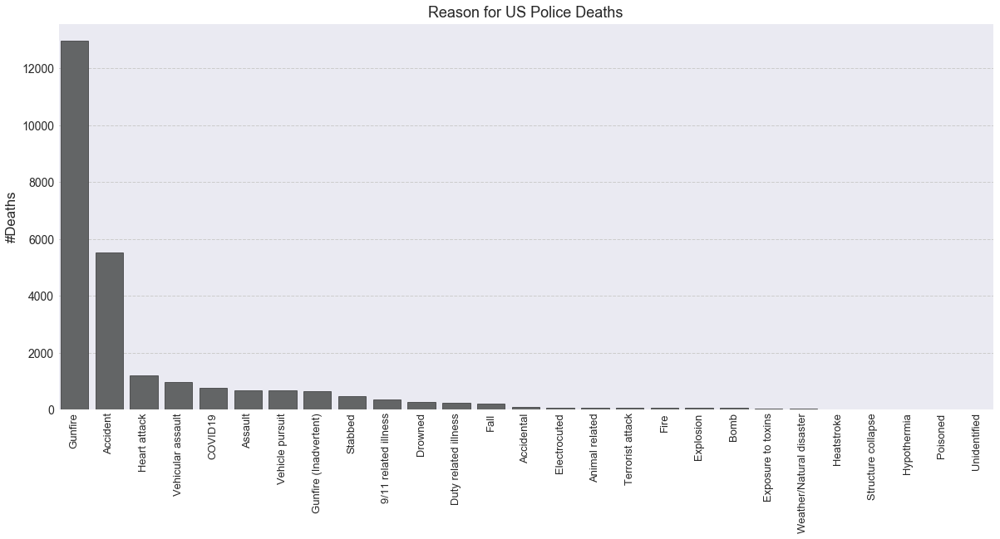

In [110]:
plt.rcParams['figure.figsize'] = (18,8)

sns.countplot(x='Reason', data=human_police_deaths_df, 
              color = '#626567', edgecolor = 'black', 
              order = human_police_deaths_df['Reason'].value_counts().index)

#formatting the graph
plt.title("Reason for US Police Deaths", fontsize = 18)

plt.xlabel(None)
plt.ylabel('#Deaths')

plt.xticks(rotation = 90, fontsize = 13)
plt.show()

In [111]:
accidents = human_police_deaths_df[human_police_deaths_df['Reason'] == 'Accident']
accidents

,Rank,Name,Cause_of_Death,Date,Year,Month,Day,Department,State,Reason
668,Police Officer,Jacob Pennington Boyer,Train accident,"Tuesday, March 6, 1877",1877,March,Tuesday,"Philadelphia Police Department, PA",Pennsylvania,Accident
669,Police Officer,Henry Lucas,Train accident,"Wednesday, March 7, 1877",1877,March,Wednesday,"Philadelphia Police Department, PA",Pennsylvania,Accident
720,Patrolman,John Dwyer,Struck by streetcar,"Thursday, July 18, 1878",1878,July,Thursday,"Cincinnati Police Department, OH",Ohio,Accident
787,Police Officer,William R. Plummer,Struck by train,"Tuesday, November 25, 1879",1879,November,Tuesday,"Pennsylvania Railroad Police Department, RR",United States,Accident
872,Town Marshal,William E. Maddox,Train accident,"Thursday, September 8, 1881",1881,September,Thursday,"Shelbyville Police Department, KY",Kentucky,Accident
...,...,...,...,...,...,...,...,...,...,...
25777,Deputy Sheriff,"Walter Donald Jenkins, Jr.",Struck by vehicle,"Wednesday, May 11, 2022",2022,May,Wednesday,"Rockdale County Sheriff's Office, GA",Georgia,Accident
25778,Deputy Sheriff,Robert Adam Howard,Automobile crash,"Wednesday, May 11, 2022",2022,May,Wednesday,"Harris County Sheriff's Office, TX",Texas,Accident
25780,Border Patrol Agent,Daniel Salazar,Automobile crash,"Tuesday, May 17, 2022",2022,May,Tuesday,United States Department of Homeland Security ...,United States,Accident
25782,Senior Correctional Police Officer,Daniel Sincavage,Automobile crash,"Thursday, May 19, 2022",2022,May,Thursday,"New Jersey Department of Corrections, NJ",New Jersey,Accident


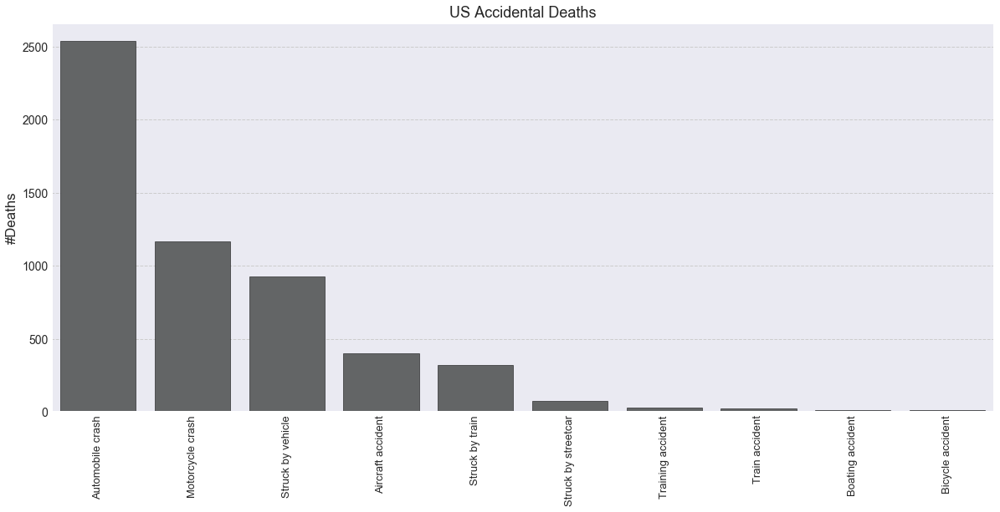

In [112]:
#grouping the deaths by accidents

plt.rcParams['figure.figsize'] = (18,8)
sns.countplot(x='Cause_of_Death', data=accidents, 
              color = '#626567', edgecolor = 'black', 
              order = accidents['Cause_of_Death'].value_counts().index)
plt.title("US Accidental Deaths", fontsize = 18)

plt.xlabel(None)
plt.ylabel('#Deaths')

plt.xticks(rotation = 90, fontsize = 13)
plt.show()

In [113]:
covid_deaths = human_police_deaths_df[human_police_deaths_df['Reason'] == 'COVID19']
print("There were US Police" , covid_deaths.shape[0] , "deaths due to COVID")
covid_deaths

There were US Police 771 deaths due to COVID


,Rank,Name,Cause_of_Death,Date,Year,Month,Day,Department,State,Reason
24668,Captain,Jonathan David Parnell,COVID19,"Tuesday, March 24, 2020",2020,March,Tuesday,"Detroit Police Department, MI",Michigan,COVID19
24670,Commander,Donafay Collins,COVID19,"Wednesday, March 25, 2020",2020,March,Wednesday,"Wayne County Sheriff's Office, MI",Michigan,COVID19
24673,Detective,Cedric G. Dixon,COVID19,"Friday, March 27, 2020",2020,March,Friday,"New York City Police Department, NY",New York,COVID19
24675,Reserve Captain,Raymond Andrew Boseman,COVID19,"Sunday, March 29, 2020",2020,March,Sunday,"New Orleans Police Department, LA",Louisiana,COVID19
24677,Deputy Constable,"Levi Kelling Arnold, Sr.",COVID19,"Monday, March 30, 2020",2020,March,Monday,First City Court of New Orleans Constable's Of...,Louisiana,COVID19
...,...,...,...,...,...,...,...,...,...,...
25748,Deputy First Class,Kenny Olander,COVID19,"Wednesday, March 2, 2022",2022,March,Wednesday,"Frederick County Sheriff's Office, MD",Maryland,COVID19
25751,Correctional Officer V,"Lonnie D. Johnson, Jr.",COVID19,"Sunday, March 6, 2022",2022,March,Sunday,Texas Department of Criminal Justice - Correct...,Texas,COVID19
25763,Deputy Sheriff,Douglas Warren Sanford,COVID19,"Tuesday, March 29, 2022",2022,March,Tuesday,"Hamilton County Sheriff's Office, IN",Indiana,COVID19
25771,Patrol Officer,Brian Lee Sember,COVID19,"Sunday, April 3, 2022",2022,April,Sunday,"Ottawa Police Department, IL",Illinois,COVID19


In [114]:
from geopy.geocoders import Nominatim

geolocator = Nominatim(user_agent="mm")

In [5]:
df.iloc[0:2]['State']

0    New York
1    New York
Name: State, dtype: object

In [7]:
df.iloc[0:2]['Department']

0    Albany County Constable's Office, NY
1    Columbia County Sheriff's Office, NY
Name: Department, dtype: object

In [8]:
address='New York'


In [9]:
location=geolocator.geocode(address)
location.raw


{'place_id': 306106444,
 'licence': 'Data © OpenStreetMap contributors, ODbL 1.0. https://osm.org/copyright',
 'osm_type': 'relation',
 'osm_id': 175905,
 'boundingbox': ['40.476578', '40.91763', '-74.258843', '-73.700233'],
 'lat': '40.7127281',
 'lon': '-74.0060152',
 'display_name': 'City of New York, New York, United States',
 'class': 'boundary',
 'type': 'administrative',
 'importance': 1.017576611451846,
 'icon': 'https://nominatim.openstreetmap.org/ui/mapicons/poi_boundary_administrative.p.20.png'}

In [10]:
location.raw['lat'], location.raw['lon']

('40.7127281', '-74.0060152')

In [11]:
def get_location(x):
    try:
        location=geolocator.geocode(address)
        return location.raw['lat'], location.raw['lon']
    except:
        return np.nan



In [ ]:
df['lat_lon'] = df.apply(get_location,axis=1)


In [ ]:
df.head(5)

* Check the nun of lat_lon column

In [ ]:
df['lat_lon'].isna().count()

In [115]:
px.histogram(df,x='Year')

* the outliers in the right side We may use log transformation to reduces the skewness

In [116]:
np.log(df['Year'])

0        7.509335
1        7.509335
2        7.510431
3        7.510978
4        7.510978
           ...   
25758    7.611842
25759    7.611842
25760    7.611842
25761    7.611842
25762    7.611842
Name: Year, Length: 25763, dtype: float64

In [117]:
np.log(df['Year']).unique()

array([7.50933527, 7.51043056, 7.51097775, 7.51152465, 7.51207125,
       7.51316355, 7.51370925, 7.51425465, 7.51534457, 7.51588909,
       7.5164333 , 7.51697722, 7.51752085, 7.51806418, 7.51860722,
       7.51914996, 7.5196924 , 7.52023456, 7.52131798, 7.52185925,
       7.52240023, 7.52294092, 7.52348131, 7.52402142, 7.52456123,
       7.52510075, 7.52563998, 7.52617891, 7.52671756, 7.52725592,
       7.52779399, 7.52833177, 7.52886926, 7.52940646, 7.52994337,
       7.53048   , 7.53101633, 7.53155238, 7.53208814, 7.53262362,
       7.53315881, 7.53369371, 7.53422833, 7.53476266, 7.5352967 ,
       7.53583046, 7.53636394, 7.53689713, 7.53743004, 7.53796266,
       7.538495  , 7.53902706, 7.53955883, 7.54009032, 7.54062153,
       7.54115246, 7.5416831 , 7.54221346, 7.54274355, 7.54327335,
       7.54380287, 7.54433211, 7.54486107, 7.54538975, 7.54591815,
       7.54644627, 7.54697412, 7.54750168, 7.54802897, 7.54855598,
       7.54908271, 7.54960917, 7.55013534, 7.55066124, 7.55118

In [118]:
df['log_Year']=np.log(df['Year'])

In [119]:
df['log_Year']

0        7.509335
1        7.509335
2        7.510431
3        7.510978
4        7.510978
           ...   
25758    7.611842
25759    7.611842
25760    7.611842
25761    7.611842
25762    7.611842
Name: log_Year, Length: 25763, dtype: float64

In [120]:
df[df['Year']==np.inf]

,Rank,Name,Cause_of_Death,Date,Year,Month,Day,Department,State,K9_Unit,log_Year


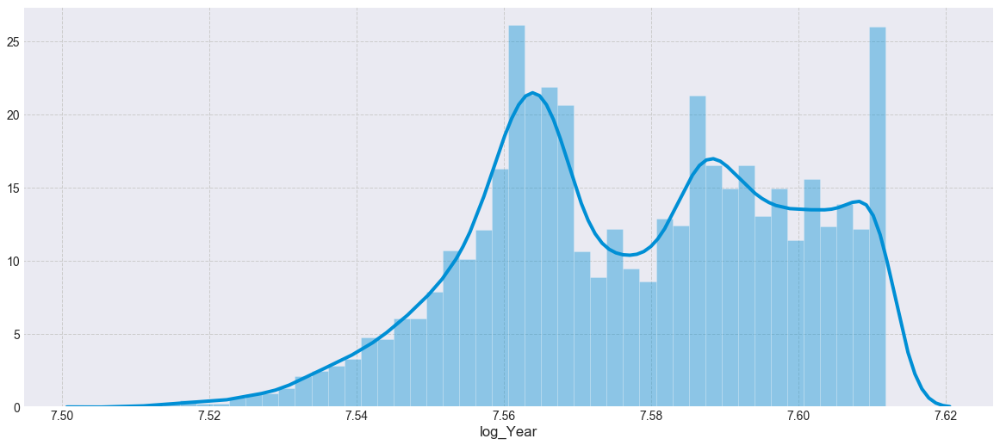

In [121]:
sns.distplot(df['log_Year'])

In [122]:
px.histogram(df,x='log_Year')

In [123]:
df.isnull().mean()*100

Rank              0.0
Name              0.0
Cause_of_Death    0.0
Date              0.0
Year              0.0
Month             0.0
Day               0.0
Department        0.0
State             0.0
K9_Unit           0.0
log_Year          0.0
dtype: float64

# Data understanding
##### Find the correlation coefficient of our columns.

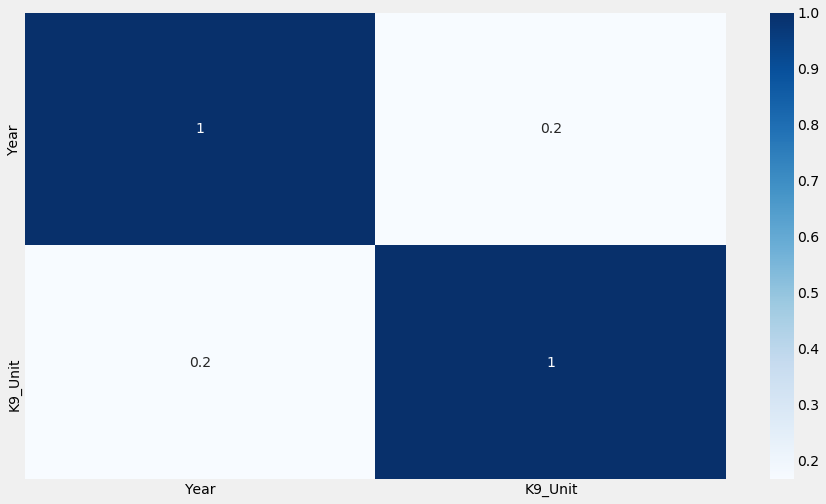

In [23]:
# visualize correlation using a heatmap
plt.figure(figsize=(14,8))
cor = df.corr()
sns.heatmap(cor, annot=True, fmt='.1g', cmap='Blues')

#sns.set(rc={"figure.figsize":(10,6)})
#sns.heatmap(df.corr(),annot=True)

 * We do not  to have strong correlation between variables.

In [24]:
df.corr()

,Year,K9_Unit
Year,1.000000,0.166705
K9_Unit,0.166705,1.000000


In [25]:
df.columns

Index(['Rank', 'Name', 'Cause_of_Death', 'Date', 'Year', 'Month', 'Day',
       'Department', 'State', 'K9_Unit'],
      dtype='object')

In [26]:
#  Q.Number 1
count_death_ofyear=df.groupby('Year').agg({
    'Cause_of_Death':'count'
}).reset_index().sort_values('Year')
count_death_ofyear

,Year,Cause_of_Death
0,1791,2
1,1792,1
2,1794,1
3,1797,2
4,1798,1
...,...,...
205,2018,216
206,2019,186
207,2020,436
208,2021,643


In [27]:
# plot 
count_death_ofyear_graph=px.bar(count_death_ofyear,x='Year',y='Cause_of_Death')


In [28]:
count_death_ofyear_graph

In [29]:
# Q.number 2
max_death=df.groupby('State').agg({
    'Cause_of_Death':'count'
}).reset_index().sort_values('Cause_of_Death',ascending=False).head(1)
max_death

,State,Cause_of_Death
48,Texas,2229


In [30]:
px.bar(max_death,x='State',y='Cause_of_Death')

In [31]:
min_death=df.groupby('State').agg({
    'Cause_of_Death':'count'
}).reset_index().sort_values('Cause_of_Death',ascending=False).tail(1)
min_death

,State,Cause_of_Death
2,American Samoa,3


In [32]:
px.bar(min_death,x='State',y='Cause_of_Death')

In [33]:
count_death_ofstate=df.groupby(['Year','State']).agg({
    'Cause_of_Death':'count'
}).reset_index().sort_values('Year')
count_death_ofstate

,Year,State,Cause_of_Death
0,1791,New York,2
1,1792,New York,1
2,1794,United States,1
3,1797,New York,1
4,1797,South Carolina,1
...,...,...,...
5822,2022,Kentucky,4
5823,2022,Louisiana,1
5824,2022,Maryland,1
5826,2022,Michigan,3


In [34]:
count_death_ofstate_graph=px.bar(count_death_ofstate,x='State',y='Cause_of_Death',color='Year')

In [35]:
count_death_ofstate_graph

In [36]:
# Q.number 7
top_10_caseofdeath=df.groupby('State').agg({
    'Cause_of_Death':'sum'
}).reset_index().head(10)
top_10_caseofdeath

,State,Cause_of_Death
0,Alabama,StabbedGunfireGunfireGunfireAssaultStabbedGunf...
1,Alaska,GunfireGunfireGunfireGunfireGunfireAircraft ac...
2,American Samoa,AssaultDrownedGunfire
3,Arizona,GunfireAssaultGunfireGunfireGunfireGunfireGunf...
4,Arkansas,GunfireGunfireAssaultGunfireGunfireGunfireGunf...
5,California,GunfireGunfireStabbedGunfireGunfireStabbedGunf...
6,Colorado,GunfireGunfireGunfireGunfire (Inadvertent)Gunf...
7,Connecticut,AssaultAssaultStabbedStabbedGunfireGunfireAssa...
8,Delaware,StabbedGunfireGunfireGunfireGunfireGunfireGunf...
9,District of Columbia,GunfireHeart attackGunfireGunfireDrownedStabbe...


In [37]:
px.bar(top_10_caseofdeath,x='Cause_of_Death',y='State')

In [135]:
top_10_year=df.groupby(['State','Year']).agg({
    'Cause_of_Death':'count'
}).reset_index().head(10)
top_10_year

,State,Year,Cause_of_Death
0,Alabama,1829,1
1,Alabama,1845,1
2,Alabama,1881,2
3,Alabama,1883,1
4,Alabama,1884,1
5,Alabama,1885,1
6,Alabama,1886,2
7,Alabama,1887,1
8,Alabama,1888,2
9,Alabama,1889,2


In [136]:
# plot
px.bar(top_10_year,x='Cause_of_Death',y='State',color='Year')

In [137]:
#(df[(df['Year']==2021) & (df['State']=='Texas')]

In [140]:
# Q.number 3
count_of_rank=df.groupby('Rank').agg({
    'Cause_of_Death':'count'
}).reset_index().sort_values('Cause_of_Death',ascending=False)
count_of_rank

,Rank,Cause_of_Death
377,Patrolman,3876
393,Police Officer,3549
190,Deputy Sheriff,3218
349,Officer,1746
492,Sergeant,1423
...,...,...
417,Probation / Parole Officer,1
171,Deputy Commander,1
419,Probation Supervisor,1
420,Probation Unit Supervisor,1


In [141]:
px.imshow(count_of_rank.corr(),text_auto=True)

In [142]:
# 
sum_of_rank=df.groupby('Rank').agg({
    'Cause_of_Death':'sum'
}).reset_index().head(10)
sum_of_rank

,Rank,Cause_of_Death
0,ALE Agent,Gunfire
1,ATSAC,Heart attack
2,Abatement Officer,Heart attack
3,Acting Chief,GunfireGunfireHeart attackGunfireGunfireMotorc...
4,Acting Chief of Police,GunfireGunfireGunfireAccidental
5,Acting Constable,Gunfire Inadvertent)Struck by vehicle
6,Acting Deputy Sheriff,Gunfire
7,Acting Detective,Gunfire
8,Acting Lieutenant,Gunfire
9,Acting Marshal,Gunfire


In [143]:
px.line(sum_of_rank,x='Rank',y='Cause_of_Death')


In [144]:
# Q.number 6
max_yearofdeath=df.groupby('Year').agg({
    'Cause_of_Death':'sum'
}).reset_index().head(1)
max_yearofdeath

,Year,Cause_of_Death
0,1825,GunfireAssault


In [145]:
px.histogram(max_yearofdeath,x='Year',y='Cause_of_Death')


In [146]:
df['Year'].min()

1825

In [147]:
df['Cause_of_Death'].max()


'related illness'

In [148]:
df['Cause_of_Death'].min()

'Accidental'

In [149]:
df['Cause_of_Death'].mode()

0    Gunfire
dtype: object

In [150]:
year_Gunfire=(df[(df['Year']>1830) & (df['Cause_of_Death']=='Gunfire')])

In [151]:
year_Gunfire

,Rank,Name,Cause_of_Death,Date,Year,Month,Day,Department,State,K9_Unit,log_Year
9,Sheriff,William Gsham,Gunfire,"Thursday, January 23, 1834",1834,January,Thursday,"Harrison County Sheriff Department, IN",Indiana,0,7.514255
15,Private,David Clark,Gunfire,"Saturday, January 7, 1837",1837,January,Saturday,Texas Rangers TX,Texas,0,7.515889
16,Private,Jams Coryll,Gunfire,"Saturday, May 27, 1837",1837,May,Saturday,Texas Rangers TX,Texas,0,7.515889
19,Private,Aleander Bostwick,Gunfire,"Friday, November 10, 1837",1837,November,Friday,Texas Rangers TX,Texas,0,7.515889
21,Private,Josph Coopr,Gunfire,"Friday, November 10, 1837",1837,November,Friday,Texas Rangers TX,Texas,0,7.515889
...,...,...,...,...,...,...,...,...,...,...,...
25744,Deputy Sheriff,Darn Almendaz,Gunfire,"Thursday, March 31, 2022",2022,March,Thursday,"Harris County Sheriff Office, TX",Texas,0,7.611842
25751,Police Officer,Roy Andw Barr,Gunfire,"Sunday, April 24, 2022",2022,April,Sunday,Cayce Police Department SC,South Carolina,0,7.611842
25753,Sergeant,Nicholas Tullier,Gunfire,"Thursday, May 5, 2022",2022,May,Thursday,"East Baton Rouge Parish Sheriff Office, LA",Louisiana,0,7.611842
25756,Chief Deputy Sheriff,Jody Wayn Cash,Gunfire,"Monday, May 16, 2022",2022,May,Monday,"Calloway County Sheriff Office, KY",Kentucky,0,7.611842


In [152]:
px.line(year_Gunfire,x='Cause_of_Death',y='Year')

In [153]:
px.histogram(year_Gunfire,x='Cause_of_Death',y='Year')

In [154]:
year_Gunfire.corr()

,Year,K9_Unit,log_Year
Year,1.000000,NaN,0.999939
K9_Unit,NaN,NaN,NaN
log_Year,0.999939,NaN,1.000000


In [155]:
#px.scatter( year_mor2000 , x = "Cause_of_Death" , y = "Year")
px.imshow(year_Gunfire.corr(),text_auto=True)

In [156]:
year_related_illness=(df[(df['Year']>1830) & (df['Cause_of_Death']=='related illness')])

In [157]:
px.imshow(year_related_illness.corr(),text_auto=True)

In [158]:
year_Accidental=(df[(df['Year']>1830) & (df['Cause_of_Death']=='Accidental')])

In [159]:
px.imshow(year_Accidental.corr(),text_auto=True)

In [160]:
# Q.number 7
cor_State_death=df[['State','Cause_of_Death','Year']]
cor_State_death.corr()

,Year
Year,1.0


In [161]:
#px.scatter(cor_State_death,x='State',y='Cause_of_Death')
px.imshow(cor_State_death.corr(),text_auto=True)

In [168]:
df[df['Cause_of_Death']=='Natural disaster']['Year'].count()

37

In [164]:
df[df['Cause_of_Death']=='Natural disaster']['Year']

363      1869
739      1879
775      1880
1091     1886
1227     1888
1946     1898
2221     1900
2222     1900
2223     1900
2224     1900
2843     1906
2878     1906
4233     1915
5114     1919
7058     1926
7914     1929
9815     1935
10856    1940
11537    1945
12459    1952
12770    1954
12801    1954
14129    1964
15239    1970
16799    1976
17236    1978
17595    1980
20869    1998
20870    1998
20879    1998
22028    2004
22476    2007
22504    2007
23194    2011
23874    2015
25394    2021
25619    2021
Name: Year, dtype: int64

In [165]:
#df[df['Year']=="2020"]['State'].count()

In [166]:
df.columns

Index(['Rank', 'Name', 'Cause_of_Death', 'Date', 'Year', 'Month', 'Day',
       'Department', 'State', 'K9_Unit', 'log_Year'],
      dtype='object')

In [167]:
df.sample()

,Rank,Name,Cause_of_Death,Date,Year,Month,Day,Department,State,K9_Unit,log_Year
864,Patrolman,ward O'Brien,Gunfire Inadvertent),"Sunday, December 18, 1881",1881,December,Sunday,Jersey City Police Department NJ,New Jersey,0,7.539559


In [168]:
#!pip install category_encoders

In [169]:
from sklearn.preprocessing import OneHotEncoder
from category_encoders import BinaryEncoder

In [183]:
encoder=BinaryEncoder()

In [184]:
cat_=encoder.fit_transform(df[['Rank','Name','Cause_of_Death','Month','Day','Department','State']])

In [185]:
df=pd.concat([df,cat_],axis=1)

In [186]:
df.drop(['Rank','Name','Cause_of_Death','Month','Day','Department','State'],axis=1,inplace=True)

In [187]:
df

,Date,Year,K9_Unit,log_Year,Rank_0,Rank_1,Rank_2,Rank_3,Rank_4,Rank_5,...,Department_9,Department_10,Department_11,Department_12,State_0,State_1,State_2,State_3,State_4,State_5
0,"Thursday, April 14, 1825",1825,0,7.509335,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0,0,1
1,"Monday, December 19, 1825",1825,0,7.509335,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,1,0
2,"Sunday, September 9, 1827",1827,0,7.510431,0,0,0,0,0,0,...,0,0,1,1,0,0,0,0,1,1
3,"Tuesday, January 8, 1828",1828,0,7.510978,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,1
4,"Tuesday, August 12, 1828",1828,0,7.510978,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25758,"Tuesday, May 17, 2022",2022,0,7.611842,1,0,0,1,1,0,...,1,0,0,1,0,0,1,1,0,1
25759,"Thursday, May 19, 2022",2022,0,7.611842,1,0,0,1,1,0,...,0,0,0,0,0,1,1,0,1,1
25760,"Friday, May 20, 2022",2022,0,7.611842,1,0,0,0,1,1,...,0,1,0,0,0,0,1,1,0,1
25761,"Sunday, May 29, 2022",2022,0,7.611842,0,0,0,0,0,1,...,0,0,1,1,0,1,0,1,0,1


# Dash board

In [76]:
features = [
    'count_death_ofstate_graph',
    'count_death_ofyear_graph'
]

In [77]:
features

['count_death_ofstate_graph', 'count_death_ofyear_graph']

In [78]:
[{'label': x, 'value': x} for x in features]

[{'label': 'count_death_ofstate_graph', 'value': 'count_death_ofstate_graph'},
 {'label': 'count_death_ofyear_graph', 'value': 'count_death_ofyear_graph'}]

In [ ]:
#!pip install dash
#!pip install plotly
#!pip install jupyter-dash
#!pip install dash_bootstrap_components

In [79]:
import dash_core_components as dcc
import dash_html_components as html

C:\Users\pc\anaconda3\lib\site-packages\ipykernel_launcher.py:1: UserWarning:


The dash_core_components package is deprecated. Please replace
`import dash_core_components as dcc` with `from dash import dcc`

C:\Users\pc\anaconda3\lib\site-packages\ipykernel_launcher.py:2: UserWarning:


The dash_html_components package is deprecated. Please replace
`import dash_html_components as html` with `from dash import html`



In [80]:
import plotly.graph_objs as go
import plotly.express as px

In [81]:
from jupyter_dash import JupyterDash
import dash_core_components as dcc

In [82]:
import dash_html_components as html

In [83]:
from dash.dependencies import Input, Output

In [84]:
import plotly.figure_factory as ff


In [85]:
import plotly.express as px

In [86]:
import dash
from dash import html, dcc, Input, Output,callback
#import dash_bootstrap_components as dbc

In [88]:
from dash import Dash, dcc, html, callback
import dash.dash_table.DataTable as table
from dash.dependencies import Input, Output, State
#import dash_bootstrap_components as dbc

In [89]:
app = Dash(
    #external_stylesheets=[dbc.themes.BOOTSTRAP]
)

In [ ]:
app.layout=html.Div(children=[
    html.H1(' show case of police deaths in america ',style={'text-align': 'center', 'color': 'blue'}),
    html.H2('Sample Data',style={'text-align': 'center', 'color': 'blue'}),
    html.Div(children=[
        dcc.Graph(id='graph_1',
             figure=px.histogram(year_group,x='Cause_of_Death',y='Year'),
             style={'width':'50%'}),
        dcc.Graph(id='graph_2',
             figure=px.histogram(year_Gunfire,x='Cause_of_Death',y='Year'),style={'margin-left': '100%'})
        
    ]),
    
    html.Div(children=[
        dcc.Graph(id='graph_1',
             figure=px.histogram(year_Gunfire,x='Cause_of_Death',y='Year'),
             style={'width':'50%'}),
        dcc.Graph(id='graph_2',
             figure=px.histogram(year_Gunfire,x='Cause_of_Death',y='Year'),style={'width':'50%'})
        
    ]),
    
    
        
        
                 
        
])
        

app.run_server(debug=False,port=8080)

Dash is running on http://127.0.0.1:8080/

 * Serving Flask app "__main__" (lazy loading)
 * Environment: production
   Use a production WSGI server instead.
 * Debug mode: off


 * Running on http://127.0.0.1:8080/ (Press CTRL+C to quit)


Exception on / [GET]
Traceback (most recent call last):
  File "C:\Users\pc\anaconda3\lib\site-packages\flask\app.py", line 2446, in wsgi_app
    response = self.full_dispatch_request()
  File "C:\Users\pc\anaconda3\lib\site-packages\flask\app.py", line 1951, in full_dispatch_request
    rv = self.handle_user_exception(e)
  File "C:\Users\pc\anaconda3\lib\site-packages\flask\app.py", line 1820, in handle_user_exception
    reraise(exc_type, exc_value, tb)
  File "C:\Users\pc\anaconda3\lib\site-packages\flask\_compat.py", line 39, in reraise
    raise value
  File "C:\Users\pc\anaconda3\lib\site-packages\flask\app.py", line 1947, in full_dispatch_request
    rv = self.preprocess_request()
  File "C:\Users\pc\anaconda3\lib\site-packages\flask\app.py", line 2241, in preprocess_request
    rv = func()
  File "C:\Users\pc\anaconda3\lib\site-packages\dash\dash.py", line 1307, in _setup_server
    _validate.validate_layout(self.layout, self._layout_value())
  File "C:\Users\pc\anaconda3\lib\s

127.0.0.1 - - [11/May/2023 19:58:15] "GET / HTTP/1.1" 500 -
127.0.0.1 - - [11/May/2023 19:58:16] "GET /favicon.ico HTTP/1.1" 200 -


In [ ]:
app.layout=html.Div(children=[
    html.H1(' show case of police deaths in america ',style={'text-align': 'center', 'color': 'blue'}),
    html.H2('Sample Data',style={'text-align': 'center', 'color': 'blue'}),
    html.Div(children=[
        dcc.Graph(id='graph_1',
             figure=count_death_ofstate_graph,
             style={'width':'50%'}),
        dcc.Graph(id='graph_2',
             figure=count_death_ofyear_graph,style={'margin-left': '100%'})
        
    ]),
    
    html.Div(children=[
        dcc.Graph(id='graph_1',
             figure=count_death_ofyear_graph,
             style={'width':'50%'}),
        dcc.Graph(id='graph_2',
             figure=count_death_ofstate_graph,style={'width':'50%'})
        
    ]),
    
    html.Div(className='row justify-content-md-center', children=[
        
        dcc.Dropdown(
                        id='dropdown-1',
                       options=[{'label': x, 'value': x} for x in features],
                        placeholder="Select a feature",
                    ),
         html.Div(className='row justify-content-md-center', children=[
        
        dcc.Dropdown(
                        id='dropdown-2',
                       options=[{'label': x, 'value': x} for x in features],
                        placeholder="Select two features",
                        multi=True
                        
                    ),
        
])
        
@app.callback(
    Output('graph-1', 'figure'),
    Input('dropdown-1', 'value')
)

@app.callback(
    Output('graph-2', 'figure'),
    Input('dropdown-2', 'value')
)

app.run_server(debug=False, port=8080)


In [ ]:
app = dash.Dash(suppress_callback_exceptions=True)

page_1 = html.Div( children=[
    html.H1('First Dashboard'),
    dcc.Graph(id='figure-1-1', figure = count_death_ofstate_graph)
]
)
page_2 = html.Div( children=[
    html.H1('Second Dashboard'),
    dcc.Graph(id='figure-1-2', figure = count_death_ofyear_graph)
]
)

app.layout = html.Div( children = [
    #dbc.Button('Page 1', href="/page1"),
    #dbc.Button('Page 2', href="/page2"),
    html.Div(id='output-page', children=''),
    dcc.Location(id='pathname-1', refresh=True)
]
)

@app.callback(
    Output(component_id='output-page', component_property='children'),
    Input(component_id='pathname-1', component_property='pathname'),
    prevent_initial_call=True
)
def update_output_div(pathname):
    if 'page1' in pathname:
        return page_1
    elif 'page2' in pathname:
        return page_2
    else:
        return dash.no_update


app.run_server(debug=False, port=8080)

Dash is running on http://127.0.0.1:8080/

Dash is running on http://127.0.0.1:8080/

Dash is running on http://127.0.0.1:8080/

Dash is running on http://127.0.0.1:8080/

Dash is running on http://127.0.0.1:8080/

Dash is running on http://127.0.0.1:8080/

 * Serving Flask app "__main__" (lazy loading)
 * Environment: production
   Use a production WSGI server instead.
 * Debug mode: off


 * Running on http://127.0.0.1:8080/ (Press CTRL+C to quit)
127.0.0.1 - - [12/May/2023 03:07:13] "GET / HTTP/1.1" 200 -
127.0.0.1 - - [12/May/2023 03:07:14] "GET /_dash-component-suites/dash/deps/react@16.v2_7_0m1670704265.14.0.min.js HTTP/1.1" 200 -
127.0.0.1 - - [12/May/2023 03:07:14] "GET /_dash-component-suites/dash/dcc/dash_core_components.v2_7_0m1670704265.js HTTP/1.1" 200 -
127.0.0.1 - - [12/May/2023 03:07:14] "GET /_dash-component-suites/dash/deps/react-dom@16.v2_7_0m1670704265.14.0.min.js HTTP/1.1" 200 -
127.0.0.1 - - [12/May/2023 03:07:14] "GET /_dash-component-suites/dash/deps/polyfill@7.v2_7_0m1670704265.12.1.min.js HTTP/1.1" 200 -
127.0.0.1 - - [12/May/2023 03:07:14] "GET /_dash-component-suites/dash/dash-renderer/build/dash_renderer.v2_7_0m1670704265.min.js HTTP/1.1" 200 -
127.0.0.1 - - [12/May/2023 03:07:14] "GET /_dash-component-suites/dash/deps/prop-types@15.v2_7_0m1670704265.8.1.min.js HTTP/1.1" 200 -
127.0.0.1 - - [12/May/2023 03:07:14] "GET /_dash-component-suites/d

In [ ]:
app = dash.Dash(suppress_callback_exceptions=True)

page_1 = html.Div( children=[
    html.H1('First Dashboard',style={'text-align': 'center', 'color': 'blue'}),
    html.H2(' show count death of year in america ',style={'text-align': 'center', 'color': 'blue'}),

    dcc.Graph(id='figure-1-1', figure = count_death_ofyear_graph)
]
)
page_2 = html.Div( children=[
    html.H1('Second Dashboard',style={'text-align': 'center', 'color': 'black'}),
    html.H2(' show count death of state in america ',style={'text-align': 'center', 'color': 'black'}),

    dcc.Graph(id='figure-1-2', figure = count_death_ofstate_graph)
]
)

app.layout = html.Div( children = [
    #dbc.Button('Page 1', href="/page1"),
    #dbc.Button('Page 2', href="/page2"),
    html.Div(id='output-page', children=''),
    dcc.Location(id='pathname-1', refresh=True)
]
)

@app.callback(
    Output(component_id='output-page', component_property='children'),
    Input(component_id='pathname-1', component_property='pathname'),
    prevent_initial_call=True
)
def update_output_div(pathname):
    if 'page1' in pathname:
        return page_1
    elif 'page2' in pathname:
        return page_2
    else:
        return dash.no_update


app.run_server(debug=False, port=8080)

Dash is running on http://127.0.0.1:8080/

Dash is running on http://127.0.0.1:8080/

Dash is running on http://127.0.0.1:8080/

Dash is running on http://127.0.0.1:8080/

Dash is running on http://127.0.0.1:8080/

Dash is running on http://127.0.0.1:8080/

 * Serving Flask app "__main__" (lazy loading)
 * Environment: production
   Use a production WSGI server instead.
 * Debug mode: off


 * Running on http://127.0.0.1:8080/ (Press CTRL+C to quit)
127.0.0.1 - - [12/May/2023 01:52:01] "GET / HTTP/1.1" 200 -
127.0.0.1 - - [12/May/2023 01:52:01] "GET /_dash-component-suites/dash/deps/polyfill@7.v2_7_0m1670704265.12.1.min.js HTTP/1.1" 200 -
127.0.0.1 - - [12/May/2023 01:52:01] "GET /_dash-component-suites/dash/deps/react@16.v2_7_0m1670704265.14.0.min.js HTTP/1.1" 200 -
127.0.0.1 - - [12/May/2023 01:52:02] "GET /_dash-component-suites/dash/deps/react-dom@16.v2_7_0m1670704265.14.0.min.js HTTP/1.1" 200 -
127.0.0.1 - - [12/May/2023 01:52:02] "GET /_dash-component-suites/dash/deps/prop-types@15.v2_7_0m1670704265.8.1.min.js HTTP/1.1" 200 -
127.0.0.1 - - [12/May/2023 01:52:02] "GET /_dash-component-suites/dash/dash-renderer/build/dash_renderer.v2_7_0m1670704265.min.js HTTP/1.1" 200 -
127.0.0.1 - - [12/May/2023 01:52:02] "GET /_dash-component-suites/dash/dcc/dash_core_components.v2_7_0m1670704265.js HTTP/1.1" 200 -
127.0.0.1 - - [12/May/2023 01:52:02] "GET /_dash-component-suites/d

In [ ]:
movies.columns[:2]

In [ ]:
app = Dash()

app.layout = html.Div([
    
        html.H1(' show case of police deaths in america ',style={'text-align': 'center', 'color': 'blue'}),
        html.H2('Sample Data'),
    table(death_count_by_year_df.to_dict('records'),
          [{"name": i, "id": i} for i in death_count_by_year_df],
          page_current=0,
        page_size=10,
        style_table={'overflowX': 'auto'},
),
    
    dcc.Graph(id='graph-1', figure=px.bar(count_death_ofyear,x='Year',y='Cause_of_Death'))
    
])


app.run_server(debug=False, port=8080)

Dash is running on http://127.0.0.1:8080/

Dash is running on http://127.0.0.1:8080/

 * Serving Flask app "__main__" (lazy loading)
 * Environment: production
   Use a production WSGI server instead.
 * Debug mode: off


 * Running on http://127.0.0.1:8080/ (Press CTRL+C to quit)
